In [1]:
import scanpy as sc
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import anndata
import scanpy.external as sce
import seaborn as sns
import matplotlib as mpl
from matplotlib.pyplot import rc_context
from matplotlib.patches import Patch
import scvelo as scv

In [2]:
rna_raw=sc.read('rna_raw.h5')


In [18]:
rna=rna_raw.copy()

In [19]:
sc.pp.pca(rna)
sc.pp.neighbors(rna, n_neighbors=20)   
sc.tl.umap(rna)
sc.tl.leiden(rna,resolution = 0.7, key_added="leiden")


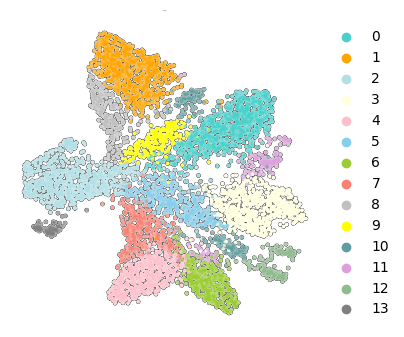

In [20]:
with rc_context({'figure.figsize': (4, 4),'axes.labelsize': False,'axes.titlesize':False}):
    sc.pl.umap(rna, color=["leiden"], size=25, outline_width=(0.1,0.05),frameon=False, add_outline=True,
               palette={'0':'mediumturquoise','1':'orange','2':'powderblue','3':'lightyellow','4':'pink','5':'skyblue',
                       '6':'yellowgreen',
                        '7':'salmon','8':'silver','9':'yellow','10':'cadetblue','11':'plum','12':'darkseagreen','13':'grey'}) 



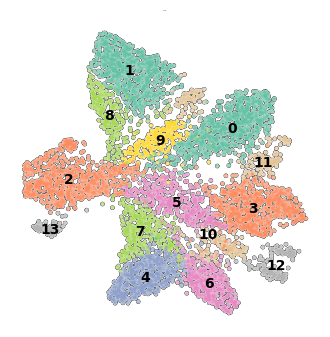

In [21]:
with rc_context({'figure.figsize': (4, 4),'axes.labelsize': False,'axes.titlesize':False}):
    sc.pl.umap(rna, color=["leiden"], size=25, add_outline=True,outline_width=(0.1,0.05),frameon=False, legend_loc='on data',palette='Set2')


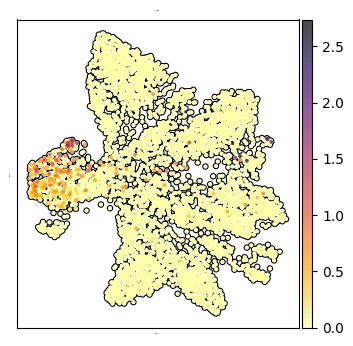

In [22]:
with rc_context({'figure.figsize': (4, 4),'axes.labelsize': False,'axes.titlesize':False}):
    sc.pl.umap(rna, color=["PAX5"], size=30, add_outline=True,cmap='inferno_r')



In [23]:
K=rna[(rna.obs_vector("IGKC")>4.5)&(rna.obs_vector("IGLC6 _2")<4)&(rna.obs_vector("IGLC_2")<4.5)&(rna.obs_vector("IGLC_1")<4)&(rna.obs_vector("IGLC_1")<0.2)&(rna.obs_vector("IGLC_6")<0.2)]
L=rna[(rna.obs_vector("IGKC")<4.5)&((rna.obs_vector("IGLC6 _2")>4)|(rna.obs_vector("IGLC_2")>4.5)|(rna.obs_vector("IGLC6 _1")>4)|(rna.obs_vector("IGLC_6")>0.2)|(rna.obs_vector("IGLC_1")>0.2)|(rna.obs_vector("IGLC_5")>1.6))]



In [24]:
E=rna_raw[(rna_raw.obs_vector("IGHE")>4)&(rna_raw.obs_vector("IGHM")<4)&(rna_raw.obs_vector("IGHG2 ")<2.5)]
M=rna_raw[(rna_raw.obs_vector("IGHM")>4)&(rna_raw.obs_vector("IGHE")<4.5)]
A=rna_raw[(rna_raw.obs_vector("IGHA1 ")>4)]
G=rna_raw[(rna_raw.obs_vector("IGHG2 ")>2.5)&(rna_raw.obs_vector("IGHM")<4.4)&(rna_raw.obs_vector("IGHA1 ")<4)]

In [25]:
M

View of AnnData object with n_obs × n_vars = 2275 × 18326
    obs: 'sample_batch', 'initial_size_unspliced', 'initial_size_spliced', 'initial_size', 'donor', 'batch', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt'
    var: 'gene_ids', 'feature_types', 'genome', 'Accession', 'Chromosome', 'End', 'Start', 'Strand', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
    uns: 'log1p'
    layers: 'ambiguous', 'counts', 'matrix', 'spliced', 'unspliced'

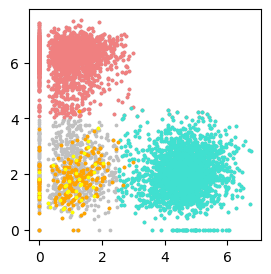

In [26]:
plt.figure(figsize=(3,3))


x="IGHG2 "
y='IGHM'
plt.scatter(rna_raw.obs_vector(x),rna_raw.obs_vector(y),color='silver',s=3)
plt.scatter(M.obs_vector(x),M.obs_vector(y),color='lightcoral',s=3)
plt.scatter(G.obs_vector(x),G.obs_vector(y),color='turquoise',s=3)
plt.scatter(A.obs_vector(x),A.obs_vector(y),color='orange',s=3)
plt.scatter(E.obs_vector(x),E.obs_vector(y),color='yellow',s=3)

plt.show()



# plt.axvline(x=2.5,linewidth=1, c='k')
# plt.axhline(y=4,linewidth=1, c='k')

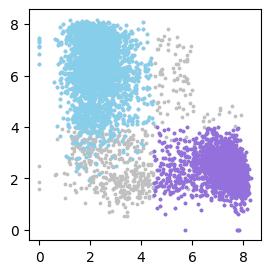

In [27]:
plt.figure(figsize=(3,3))


x="IGKC"
y='IGLC6 _2'
plt.scatter(rna.obs_vector(x),rna.obs_vector(y),color='silver',s=3)
plt.scatter(K.obs_vector(x),K.obs_vector(y),color='mediumpurple',s=3)
plt.scatter(L.obs_vector(x),L.obs_vector(y),color='skyblue',s=3)
# plt.scatter(A.obs_vector(x),A.obs_vector(y),color='orange',s=3)
# plt.scatter(E.obs_vector(x),E.obs_vector(y),color='yellow',s=3)

# plt.axvline(x=4.5,linewidth=1, c='k')
# plt.axhline(y=0.2,linewidth=1, c='k')
plt.show()



In [28]:
rna.obs['class']='x'
Mi=M.obs.index
Ai=A.obs.index
Gi=G.obs.index
Ei=E.obs.index
rna.obs.loc[Mi, 'class'] = 'M'
rna.obs.loc[Ai, 'class'] = 'A'
rna.obs.loc[Gi, 'class'] = 'G'
rna.obs.loc[Ei, 'class'] = 'E'

In [29]:
rna.obs['IgH']='x'
Ki=K.obs.index
Li=L.obs.index

rna.obs.loc[Ki, 'IgH'] = 'K'
rna.obs.loc[Li, 'IgH'] = 'L'



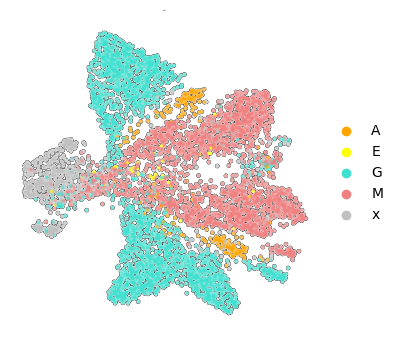

In [30]:
with rc_context({'figure.figsize': (4, 4),'axes.labelsize': False,'axes.titlesize':False}):
    sc.pl.umap(rna, color=["class"], size=25, outline_width=(0.1,0.05),frameon=False, add_outline=True,
              palette={'G':'turquoise','A':'orange','M':'lightcoral','E':'yellow','x':'silver'}) 




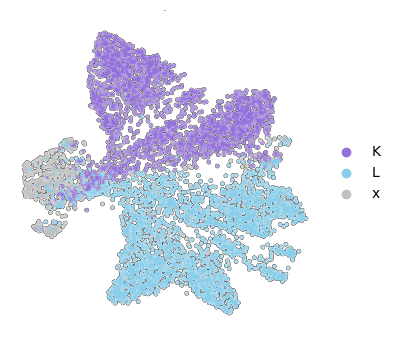

In [31]:
with rc_context({'figure.figsize': (4, 4),'axes.labelsize': False,'axes.titlesize':False}):
    sc.pl.umap(rna, color=["IgH"], size=25, outline_width=(0.1,0.05),frameon=False, add_outline=True,
              palette={'K':'mediumpurple','L':'skyblue','x':'silver'}) 

In [68]:
# with rc_context({'figure.figsize': (4, 4),'axes.labelsize': False,'axes.titlesize':False}):
#     ax= sc.pl.umap(rna, size=20,show=False)    
#     sc.pl.umap(n633_, color='donor',size=30,alpha=0.9,ax=ax,palette={
#         "633":"lightcoral" },frameon=False,legend_loc=None)
# with rc_context({'figure.figsize': (4, 4),'axes.labelsize': False,'axes.titlesize':False}):
#     ax= sc.pl.umap(rna, size=20,show=False)    
#     sc.pl.umap(n669_, color='donor',size=30,alpha=0.9,ax=ax,palette={
#         "669":"steelblue" },frameon=False,legend_loc=None)   

In [32]:
donora=rna[rna.obs.donor=='633']
donorb=rna[rna.obs.donor=='669']

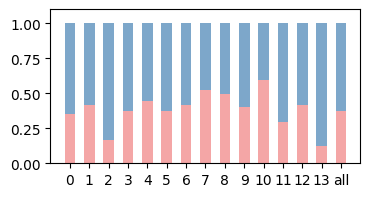

leiden,0,1,2,3,4,5,6,7,8,9,10,11,12,13,all
donor,,,,,,,,,,,,,,,
633,0.348837,0.418256,0.169468,0.375897,0.441815,0.376812,0.419098,0.520124,0.493976,0.399123,0.597633,0.295597,0.41958,0.125,0.376796
669,0.651163,0.581744,0.830532,0.624103,0.558185,0.623188,0.580902,0.479876,0.506024,0.600877,0.402367,0.704403,0.58042,0.875,0.623204


In [33]:
d=rna.obs
dd=d.groupby('leiden')['donor'].value_counts(normalize=True).unstack('leiden')
al=d['donor'].value_counts(normalize=True)
dd['all']= al

labels = dd.columns

d633 = dd.iloc[0]
d669 = dd.iloc[1]


fig = plt.figure(figsize=(4,2))
ax = fig.add_subplot(111)
width = 0.55       # the width of the bars: can also be len(x) sequence

ax.bar(labels, d633, width, label='633',color='lightcoral',alpha=0.7)
ax.bar(labels, d669, width, bottom=d633,color='steelblue',alpha=0.7,
       label='grey area')


plt.ylim(0,1.1)

# plt.savefig('gbar.pdf')
# plt.legend(loc='upper right')
plt.show()
dd

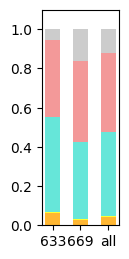

donor,633,669,all
class,,,
A,0.062440,0.027378,0.040589
E,0.006196,0.006628,0.006466
G,0.485224,0.390778,0.426365
M,0.389895,0.414986,0.405532
x,0.056244,0.160231,0.121049


In [34]:
d=rna.obs
dd=d.groupby('donor')['class'].value_counts(normalize=True).unstack('donor')
al=d['class'].value_counts(normalize=True)
dd['all']= al

labels = dd.columns

A = dd.iloc[0]
E = dd.iloc[1]
G = dd.iloc[2]
M = dd.iloc[3]
x = dd.iloc[4]




fig = plt.figure(figsize=(1,2.8))
ax = fig.add_subplot(111)
width = 0.55       # the width of the bars: can also be len(x) sequence

ax.bar(labels, A, width,color='orange',alpha=0.8)
ax.bar(labels, E, width, bottom=A,color='yellow',alpha=0.8)
ax.bar(labels, G, width, bottom=A+E,color='turquoise',alpha=0.8)
ax.bar(labels, M, width, bottom=A+E+G,color='lightcoral',alpha=0.8)
ax.bar(labels, x, width, bottom=A+E+G+M,color='silver',alpha=0.8)





plt.ylim(0,1.1)

# plt.savefig('gbar.pdf')
# plt.legend(loc='upper right')
plt.show()
dd

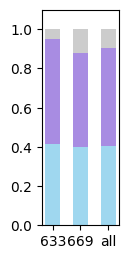

donor,633,669,all
IgH,,,
K,0.412774,0.396830,0.402838
L,0.537655,0.481268,0.502514
x,0.049571,0.121902,0.094648


In [35]:
d=rna.obs
dd=d.groupby('donor')['IgH'].value_counts(normalize=True).unstack('donor')
al=d['IgH'].value_counts(normalize=True)
dd['all']= al

labels = dd.columns

L = dd.iloc[0]
K = dd.iloc[1]
x = dd.iloc[2]




fig = plt.figure(figsize=(1,2.8))
ax = fig.add_subplot(111)
width = 0.55       # the width of the bars: can also be len(x) sequence

ax.bar(labels, L, width,color='skyblue',alpha=0.8)
ax.bar(labels, K, width, bottom=L,color='mediumpurple',alpha=0.8)
ax.bar(labels, x, width, bottom=K+L,color='silver',alpha=0.8)






plt.ylim(0,1.1)

# plt.savefig('gbar.pdf')
# plt.legend(loc='upper right')
plt.show()
dd

In [37]:
rnah=rna_raw.copy()
iglist2=rnah.var_names.str.startswith(('IGK','IGLC','IGLV','IGHV'))
rnah=rnah[:,~iglist2]
rnah


View of AnnData object with n_obs × n_vars = 5568 × 18189
    obs: 'sample_batch', 'initial_size_unspliced', 'initial_size_spliced', 'initial_size', 'donor', 'batch', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt'
    var: 'gene_ids', 'feature_types', 'genome', 'Accession', 'Chromosome', 'End', 'Start', 'Strand', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
    uns: 'log1p'
    layers: 'ambiguous', 'counts', 'matrix', 'spliced', 'unspliced'

In [38]:
sc.pp.pca(rnah)
sc.pp.neighbors(rnah, n_neighbors=20)   
sc.tl.umap(rnah)
sc.tl.leiden(rnah,resolution = 1, key_added="leiden")

In [39]:
rnah.obs['leiden_ex']=rna.obs['leiden']
rnah.obs['class']=rna.obs['class']
rnah.obs['IgH']=rna.obs['IgH']

In [2]:
# rnah.write('rnah.h5')

In [3]:
rnah=sc.read('rnah.h5')

In [45]:
sum(rnah.obs['IgH']=='K')/sum(rnah.obs['IgH']=='L')

0.8016440314510365

In [46]:
rnah

AnnData object with n_obs × n_vars = 5568 × 18189
    obs: 'sample_batch', 'initial_size_unspliced', 'initial_size_spliced', 'initial_size', 'donor', 'batch', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'leiden_ex', 'class', 'IgH', 'phenoclass', 'pheno'
    var: 'gene_ids', 'feature_types', 'genome', 'Accession', 'Chromosome', 'End', 'Start', 'Strand', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
    uns: 'IgH_colors', 'class_colors', 'leiden', 'leiden_colors', 'log1p', 'neighbors', 'pca', 'pheno_colors', 'phenoclass_colors', 'rank_genes_groups', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'ambiguous', 'counts', 'matrix', 'spliced', 'unspliced'
    obsp: 'connectivities', 'distances'

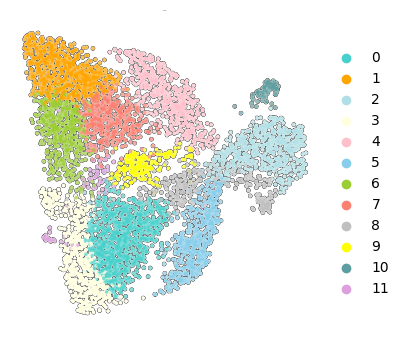

In [48]:
with rc_context({'figure.figsize': (4, 4),'axes.labelsize': False,'axes.titlesize':False}):
    sc.pl.umap(rnah, color=["leiden"], size=25, outline_width=(0.1,0.05),frameon=False, add_outline=True,
               palette={'0':'mediumturquoise','1':'orange','2':'powderblue','3':'lightyellow','4':'pink','5':'skyblue',
                       '6':'yellowgreen',
                        '7':'salmon','8':'silver','9':'yellow','10':'cadetblue','11':'plum','12':'darkseagreen','13':'grey','14':'lightgreen'}) 



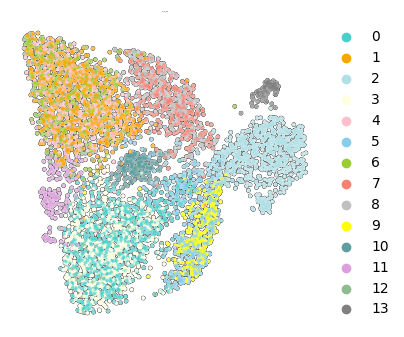

In [49]:

with rc_context({'figure.figsize': (4, 4),'axes.labelsize': False,'axes.titlesize':False}):
    sc.pl.umap(rnah, color=["leiden_ex"], size=25, outline_width=(0.1,0.05),frameon=False, add_outline=True,
               palette={'0':'mediumturquoise','1':'orange','2':'powderblue','3':'lightyellow','4':'pink','5':'skyblue',
                       '6':'yellowgreen',
                        '7':'salmon','8':'silver','9':'yellow','10':'cadetblue','11':'plum','12':'darkseagreen','13':'grey'}) 



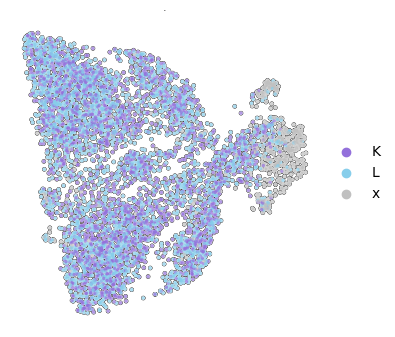

In [50]:
with rc_context({'figure.figsize': (4, 4),'axes.labelsize': False,'axes.titlesize':False}):
    sc.pl.umap(rnah, color=["IgH"], size=25, outline_width=(0.1,0.05),frameon=False, add_outline=True,
              palette={'K':'mediumpurple','L':'skyblue','x':'silver'}) 

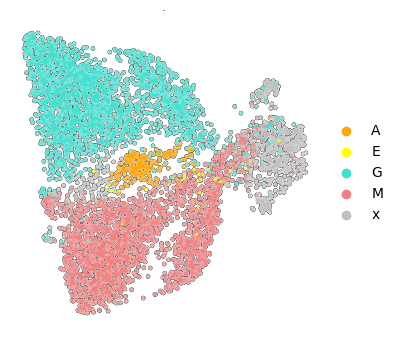

In [51]:
 
with rc_context({'figure.figsize': (4, 4),'axes.labelsize': False,'axes.titlesize':False}):
    sc.pl.umap(rnah, color=["class"], size=25, outline_width=(0.1,0.05),frameon=False, add_outline=True,
              palette={'G':'turquoise','A':'orange','M':'lightcoral','E':'yellow','x':'silver'}) 

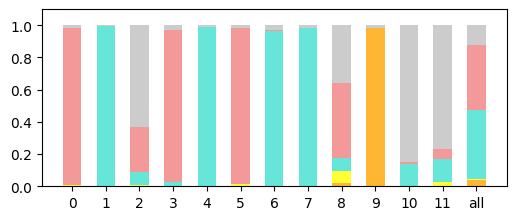

leiden,0,1,2,3,4,5,6,7,8,9,10,11,all
class,,,,,,,,,,,,,
A,0.001098,0.000000,0.001675,0.001718,0.001812,0.003759,0.000000,0.000000,0.022140,0.981651,0.000000,0.000000,0.040589
E,0.005488,0.000000,0.008375,0.000000,0.000000,0.009398,0.000000,0.000000,0.070111,0.000000,0.000000,0.028571,0.006466
G,0.001098,0.996109,0.078727,0.024055,0.985507,0.000000,0.963178,0.985011,0.081181,0.000000,0.135802,0.142857,0.426365
M,0.975851,0.000000,0.279732,0.943299,0.001812,0.971805,0.005814,0.000000,0.468635,0.000000,0.012346,0.057143,0.405532
x,0.016465,0.003891,0.631491,0.030928,0.010870,0.015038,0.031008,0.014989,0.357934,0.018349,0.851852,0.771429,0.121049


In [52]:
d=rnah.obs
dd=d.groupby('leiden')['class'].value_counts(normalize=True).unstack('leiden')
al=d['class'].value_counts(normalize=True)
dd['all']= al

labels = dd.columns

A = dd.iloc[0]
E = dd.iloc[1]
G = dd.iloc[2]
M = dd.iloc[3]
x = dd.iloc[4]




fig = plt.figure(figsize=(6,2.3))
ax = fig.add_subplot(111)
width = 0.55       # the width of the bars: can also be len(x) sequence

ax.bar(labels, A, width,color='orange',alpha=0.8)
ax.bar(labels, E, width, bottom=A,color='yellow',alpha=0.8)
ax.bar(labels, G, width, bottom=A+E,color='turquoise',alpha=0.8)
ax.bar(labels, M, width, bottom=A+E+G,color='lightcoral',alpha=0.8)
ax.bar(labels, x, width, bottom=A+E+G+M,color='silver',alpha=0.8)





plt.ylim(0,1.1)

# plt.savefig('gbar.pdf')
# plt.legend(loc='upper right')
plt.show()
dd

In [55]:
# with rc_context({'figure.figsize': (4, 4),'axes.labelsize': False,'axes.titlesize':False}):
#     sc.pl.umap(rnah, color=["IGHD",'CD79A','CD79B','MS4A1','MAP3K8','BANK1','REL','BIRC3','PTPN6'],cmap='Purples', size=30)
#     sc.pl.umap(rnah, color=["MAMU-DPA",'MAMU-DOA','MAMU-DMB','MAMU-DOB','MAMU-DRB1','MAMU-DRA'],cmap='Purples', size=30)
#     sc.pl.umap(rnah, color=["MAMU-A",'HLA, B-15 ACHAIN','HLA, B-38 ACHAIN_2','MAMU-E','MAMU-F','HLA-G'],cmap='Purples', size=30)
#     sc.pl.umap(rnah, color=["AICDA",'CIITA','MKI67','IRF4','SDC1'],cmap='Purples', size=30)


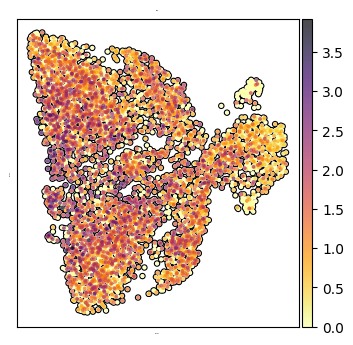

In [56]:
with rc_context({'figure.figsize': (4, 4),'axes.labelsize': False,'axes.titlesize':False}):

    sc.pl.umap(rnah, color=['IRF4',],cmap='inferno_r', size=30,add_outline=True)

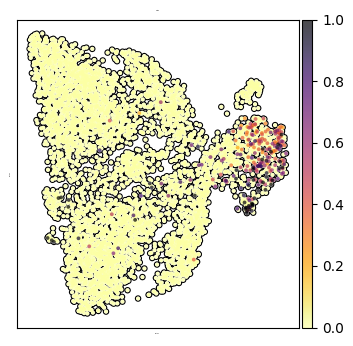

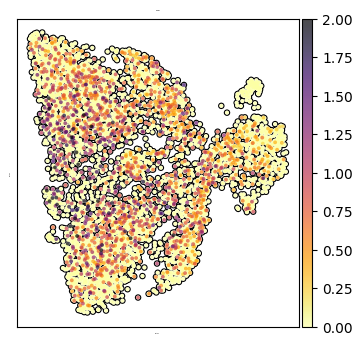

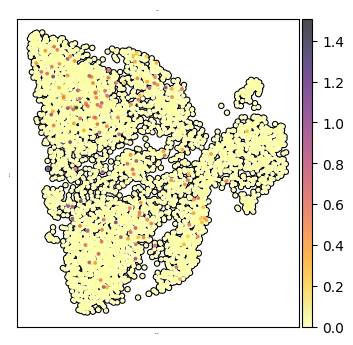

In [57]:
with rc_context({'figure.figsize': (4, 4),'axes.labelsize': False,'axes.titlesize':False}):

    sc.pl.umap(rnah, color=['PAX5',],cmap='inferno_r', size=30,add_outline=True,vmax=1)
    sc.pl.umap(rnah, color=['PRDM1',],cmap='inferno_r', size=30,add_outline=True,vmax=2)
    sc.pl.umap(rnah, color=['SDC1',],cmap='inferno_r', size=30,add_outline=True)




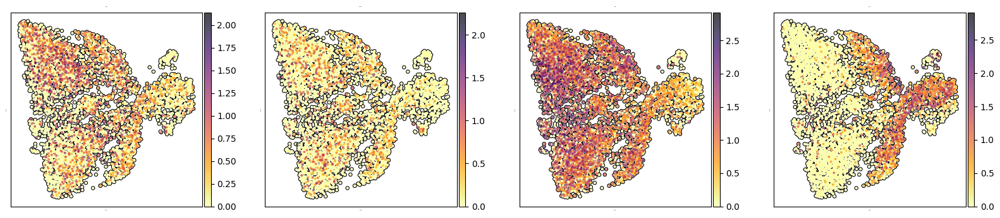

In [59]:
with rc_context({'figure.figsize': (4, 4),'axes.labelsize': False,'axes.titlesize':False}):

    sc.pl.umap(rnah, color=['CD38','SLAMF7','XBP1','MKI67'],cmap='inferno_r', size=30,add_outline=True)




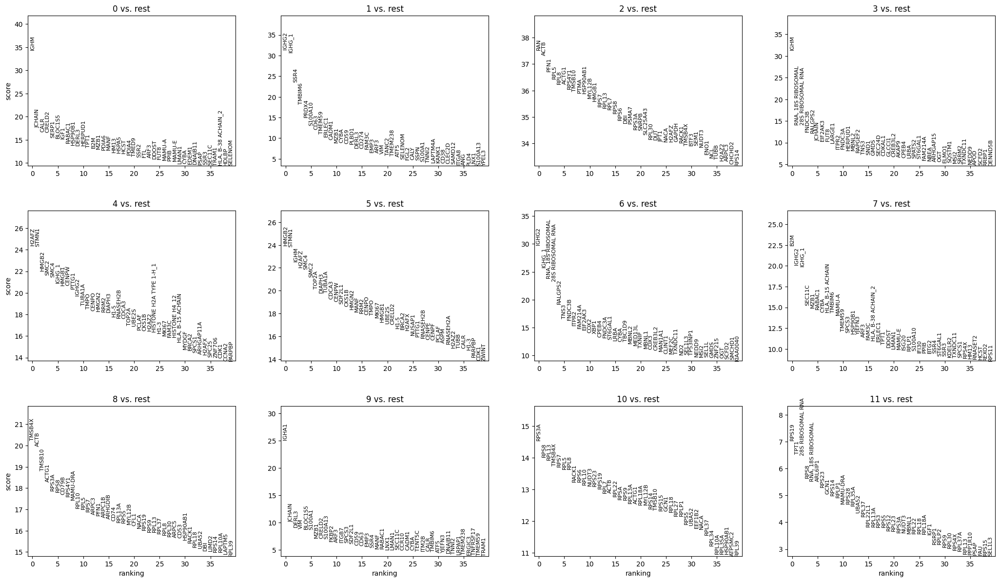

In [60]:
sc.tl.rank_genes_groups(rnah, 'leiden', method='wilcoxon')
sc.pl.rank_genes_groups(rnah, n_genes=40, sharey=False)

In [408]:
# rnah.obs['phenoclass'] = (
#     rnah.obs["leiden"]
#     .map(lambda x: {"10": "amb",'2':'ActB','8':'prePB','5':'mPB','0':'mPC','4':'gPB','7':'gPC','1':'gPC','9':'aPC','6':'hMT','3':'hMT','11':'lo'}.get(x, x))
#     .astype("category")
# )

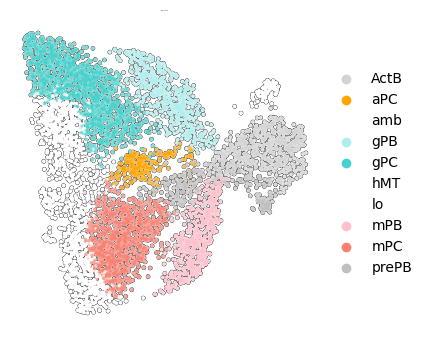

In [121]:
with rc_context({'figure.figsize': (4, 4),'axes.labelsize': False,'axes.titlesize':False}):
    sc.pl.umap(rnah, color=["phenoclass"], size=25, outline_width=(0.1,0.05),frameon=False, add_outline=True,
              palette={'lo':'white','ActB':'lightgrey','amb':'white','prePB':'silver','mPB':'pink',
                      'mPC':'salmon','gPB':'paleturquoise','gPC':'mediumturquoise','aPC':'orange','hMT':'white'})

In [6]:
#remove clustere with high MT and low cell number
rnan=rnah[(rnah.obs.leiden!='6')&(rnah.obs.leiden!='3')&(rnah.obs.leiden!='11')&(rnah.obs.leiden!='10')]

In [4]:
marker_gene=['MAMU-DPA','MS4A1','CD79B','PAX5','AICDA','MKI67','CDK1','IRF4','PRDM1','XBP1','CD38','SDC1','SLAMF7','PECAM1','JCHAIN','MZB1',
             'SSR4','LMAN1','TNFRSF13B','TNFRSF13C','TNFRSF17',]

In [94]:
marker_gene=['SSR4','CYBA','MZB1','ITPR2','TMBIM6',
             'CD59',"B2M",'MAMU-A','HLA, B-38 ACHAIN_2','MAMU-E','HLA-G','CD79A','CD274','CD63','CD38','SDC1','SLAMF7','ICAM2']

In [23]:
marker_gene=['BAX','BAD','BAK1','BID','PMAIP1','BNIP3','BNIP3L',
             'CASP3','CASP7','DDIT3','CYCS','HTRA2','VDAC1','FOXO3',
             'FADD','DFFA','XKR8','ROCK1']

In [28]:
marker_gene=['TMBIM6','BCL2','BCL2L1','MCL1']

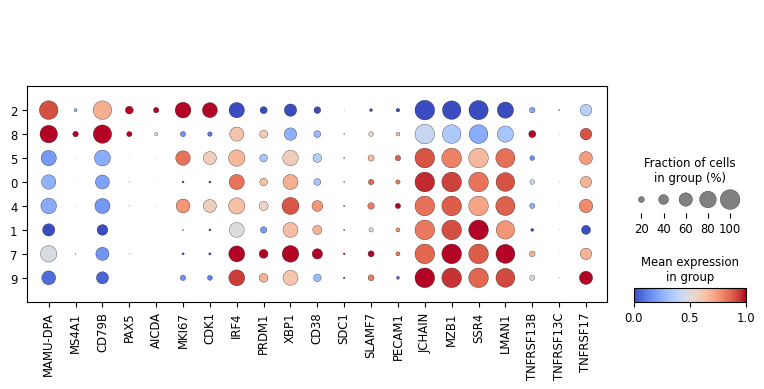

In [15]:
# sc.pl.dotplot(rnan, marker_gene, 'leiden',cmap='coolwarm', standard_scale='var', colorbar_title='column scaled\nexpression',
#              categories_order=['2','8','5','0','4','1','7','9',])

sc.pl.DotPlot(rnan, marker_gene, 'leiden',cmap='coolwarm', standard_scale='var', 
                      categories_order=['2','8','5','0','4','1','7','9',]).savefig("figure2a.pdf")

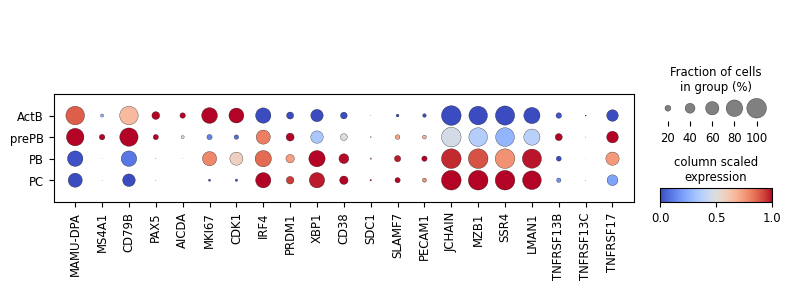

In [77]:
sc.pl.dotplot(rnan, marker_gene, 'pheno',cmap='coolwarm', standard_scale='var', colorbar_title='column scaled\nexpression',
             categories_order=['ActB','prePB','PB','PC'])

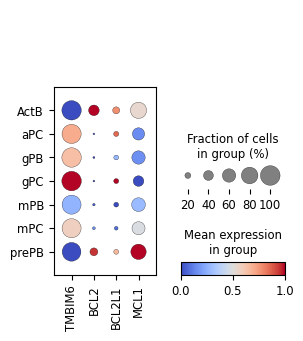

In [29]:
sc.pl.DotPlot(rnan, marker_gene, 'phenoclass',cmap='coolwarm', standard_scale='var', 
             ).savefig('figure3g2.pdf')

In [72]:
marker_gene=rnan.var_names[rnan.var_names.str.startswith('HLA')]

In [80]:
rnan.obs.leiden

AAACCCAGTGAC-0    4
AAACGCTAGCCG-0    7
AAAGAACAGCGC-0    0
AAAGAACCACCA-0    0
AAAGGATGTCTT-0    4
                 ..
TTTGGTTCAACA-1    2
TTTGTTGGTGGT-1    9
TTTGTTGGTTCA-1    0
TTTGTTGTCCTT-1    7
TTTGTTGTCTCT-1    7
Name: leiden, Length: 4319, dtype: category
Categories (8, object): ['0', '1', '2', '4', '5', '7', '8', '9']

In [89]:
rnan.var_names[rnann.var_names.str.startswith('TMBIM')]

Index(['TMBIM4', 'TMBIM6', 'TMBIM1'], dtype='object')

In [20]:
marker_gene=['FAM3C','S100A10','CD38','CD63','CD274','CD59','CADM1','EMP3','CRELD2','MANF','HSPA5','CCR10','TAPBPL','SLAMF7','ICAM2',]

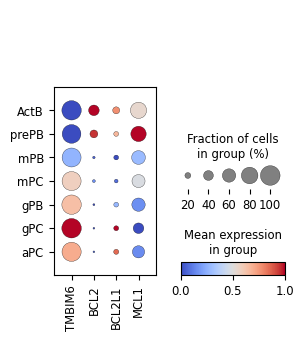

In [30]:
sc.pl.DotPlot(rnan, marker_gene, 'phenoclass',cmap='coolwarm', standard_scale='var', 
              categories_order=['ActB','prePB','mPB','mPC','gPB','gPC','aPC',]).savefig('figure3g2.pdf')


In [41]:
# marker_gene=["BSG",'CADM1',"CCR10","CD38",'CD160','HLA, B-38 ACHAIN_2','HLA-G','ICAM2','IGFLR1','IL6ST',
#              'ITGA8','ITGAE','ITGB7','ITM2A','ITM2B','ITM2C','SELPLG',"SEMA4D",'SLAMF7']
# marker_gene=['B2M','MAMU-A','MAMU-E','CD59','CD63',
#              'CD79A','CD274','SLC39A4'
#             ]
marker_gene=['MZB1','SSR4','JCHAIN','TMBIM6','CD38',
             'SLAMF7','ICAM2','SDC1','CCR10'
            ]
marker_gene=['CD59','CD79A',"CD63",'CADM1','BSG']

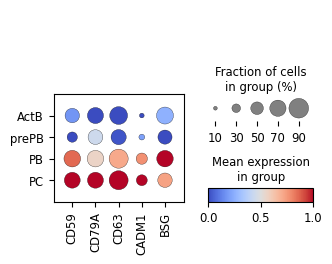

In [42]:
sc.pl.DotPlot(rnan,marker_gene , 'pheno',cmap='coolwarm', standard_scale='var', 
              categories_order=['ActB','prePB','PB','PC']).savefig('figure6C2.pdf')

In [614]:
# rnah.write('rnah.h5')

In [412]:
# rnan.write('rnan.h5')

AnnData object with n_obs × n_vars = 5568 × 18189
    obs: 'sample_batch', 'initial_size_unspliced', 'initial_size_spliced', 'initial_size', 'donor', 'batch', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'leiden_ex', 'class', 'IgH', 'phenoclass', 'pheno'
    var: 'gene_ids', 'feature_types', 'genome', 'Accession', 'Chromosome', 'End', 'Start', 'Strand', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
    uns: 'IgH_colors', 'class_colors', 'leiden', 'leiden_colors', 'log1p', 'neighbors', 'pca', 'pheno_colors', 'phenoclass_colors', 'rank_genes_groups', 'umap', 'leiden_ex_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'ambiguous', 'counts', 'matrix', 'spliced', 'unspliced'
    obsp: 'connectivities', 'distances'

In [92]:
rnan

View of AnnData object with n_obs × n_vars = 4319 × 18189
    obs: 'sample_batch', 'initial_size_unspliced', 'initial_size_spliced', 'initial_size', 'donor', 'batch', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'leiden_ex', 'class', 'IgH', 'phenoclass', 'pheno'
    var: 'gene_ids', 'feature_types', 'genome', 'Accession', 'Chromosome', 'End', 'Start', 'Strand', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
    uns: 'IgH_colors', 'class_colors', 'leiden', 'leiden_colors', 'log1p', 'neighbors', 'pca', 'pheno_colors', 'phenoclass_colors', 'rank_genes_groups', 'umap', 'leiden_ex_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'ambiguous', 'counts', 'matrix', 'spliced', 'unspliced'
    obsp: 'connectivities', 'distances'

In [196]:
rnavh=rnan.copy()


In [93]:
rnavh=sc.read('rnavh.h5')

In [94]:
scv.pp.filter_and_normalize(rnavh, min_shared_counts=20, n_top_genes=10000)
scv.pp.moments(rnavh, n_pcs=15, n_neighbors=40)

Filtered out 651 genes that are detected 20 counts (shared).
Skip filtering by dispersion since number of variables are less than `n_top_genes`.
Logarithmized X.
computing moments based on connectivities


/opt/homebrew/lib/python3.11/site-packages/scvelo/preprocessing/utils.py:705: DeprecationWarning: `log1p` is deprecated since scVelo v0.3.0 and will be removed in a future version. Please use `log1p` from `scanpy.pp` instead.
  log1p(adata)


    finished (0:00:01) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)


In [199]:
scv.tl.velocity(rnavh)

computing velocities
    finished (0:00:01) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)


In [200]:
scv.tl.velocity_graph(rnavh)



computing velocity graph (using 1/8 cores)


  0%|          | 0/4319 [00:00<?, ?cells/s]

    finished (0:00:12) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


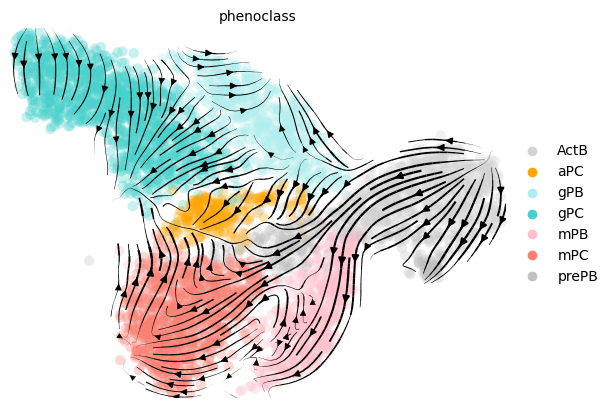

In [201]:
scv.pl.velocity_embedding_stream(rnavh, basis='umap',color='phenoclass', legend_loc='right')



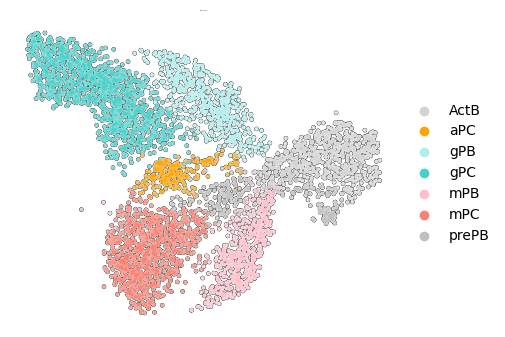

In [41]:
with rc_context({'figure.figsize': (5, 4),'axes.labelsize': False,'axes.titlesize':False}):
    sc.pl.umap(rnavh, color=["phenoclass"], size=25, outline_width=(0.1,0.05),frameon=False, add_outline=True)

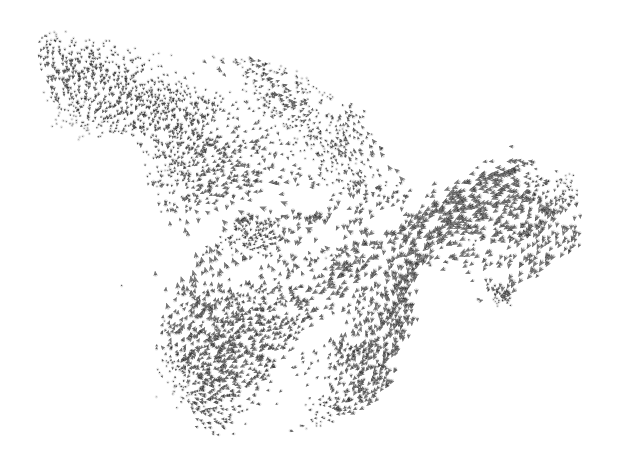

In [596]:
scv.pl.velocity_embedding(rnavh, dpi=120, arrow_size=10, arrow_length=2
                         )


/Users/ycheng/anaconda3/envs/scanpy2/lib/python3.8/site-packages/scvelo/plotting/utils.py:869: MatplotlibDeprecationWarning: The draw_all function was deprecated in Matplotlib 3.6 and will be removed two minor releases later. Use fig.draw_without_rendering() instead.
  cb.draw_all()


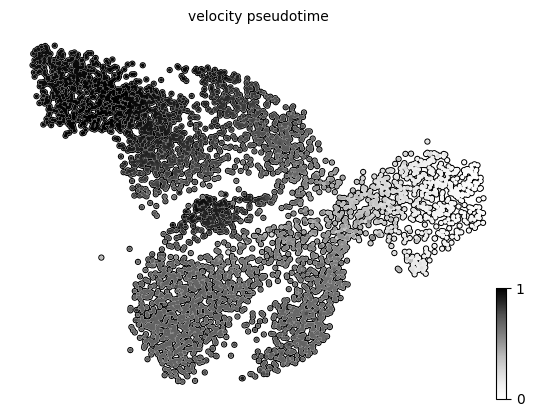

In [613]:
scv.tl.velocity_pseudotime(rnavh)

scv.pl.scatter(rnavh, color='velocity_pseudotime', cmap='Greys',add_outline=True)


In [204]:
rnavh.var_names[rnavh.var_names.str.startswith('MAMU')]

Index(['MAMU-DPA', 'MAMU-A', 'MAMU-DMB', 'MAMU-DOB', 'MAMU-DRB1', 'MAMU-DRA',
       'MAMU-E'],
      dtype='object')

/Users/ycheng/anaconda3/envs/scanpy2/lib/python3.8/site-packages/scvelo/plotting/utils.py:869: MatplotlibDeprecationWarning: The draw_all function was deprecated in Matplotlib 3.6 and will be removed two minor releases later. Use fig.draw_without_rendering() instead.
  cb.draw_all()
/Users/ycheng/anaconda3/envs/scanpy2/lib/python3.8/site-packages/scvelo/plotting/utils.py:869: MatplotlibDeprecationWarning: The draw_all function was deprecated in Matplotlib 3.6 and will be removed two minor releases later. Use fig.draw_without_rendering() instead.
  cb.draw_all()
/Users/ycheng/anaconda3/envs/scanpy2/lib/python3.8/site-packages/scvelo/plotting/utils.py:869: MatplotlibDeprecationWarning: The draw_all function was deprecated in Matplotlib 3.6 and will be removed two minor releases later. Use fig.draw_without_rendering() instead.
  cb.draw_all()
/Users/ycheng/anaconda3/envs/scanpy2/lib/python3.8/site-packages/scvelo/plotting/utils.py:869: MatplotlibDeprecationWarning: The draw_all function w

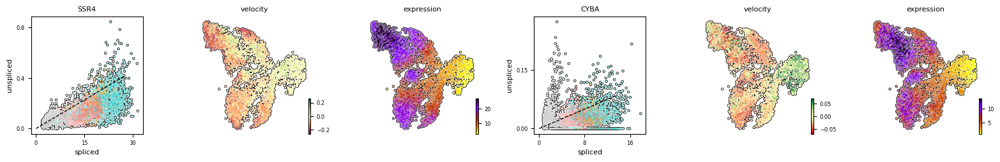

/Users/ycheng/anaconda3/envs/scanpy2/lib/python3.8/site-packages/scvelo/plotting/utils.py:869: MatplotlibDeprecationWarning: The draw_all function was deprecated in Matplotlib 3.6 and will be removed two minor releases later. Use fig.draw_without_rendering() instead.
  cb.draw_all()
/Users/ycheng/anaconda3/envs/scanpy2/lib/python3.8/site-packages/scvelo/plotting/utils.py:869: MatplotlibDeprecationWarning: The draw_all function was deprecated in Matplotlib 3.6 and will be removed two minor releases later. Use fig.draw_without_rendering() instead.
  cb.draw_all()
/Users/ycheng/anaconda3/envs/scanpy2/lib/python3.8/site-packages/scvelo/plotting/utils.py:869: MatplotlibDeprecationWarning: The draw_all function was deprecated in Matplotlib 3.6 and will be removed two minor releases later. Use fig.draw_without_rendering() instead.
  cb.draw_all()
/Users/ycheng/anaconda3/envs/scanpy2/lib/python3.8/site-packages/scvelo/plotting/utils.py:869: MatplotlibDeprecationWarning: The draw_all function w

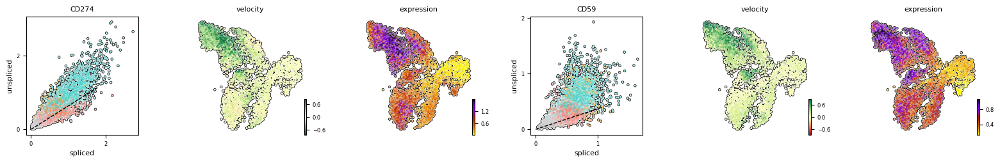

/Users/ycheng/anaconda3/envs/scanpy2/lib/python3.8/site-packages/scvelo/plotting/utils.py:869: MatplotlibDeprecationWarning: The draw_all function was deprecated in Matplotlib 3.6 and will be removed two minor releases later. Use fig.draw_without_rendering() instead.
  cb.draw_all()
/Users/ycheng/anaconda3/envs/scanpy2/lib/python3.8/site-packages/scvelo/plotting/utils.py:869: MatplotlibDeprecationWarning: The draw_all function was deprecated in Matplotlib 3.6 and will be removed two minor releases later. Use fig.draw_without_rendering() instead.
  cb.draw_all()
/Users/ycheng/anaconda3/envs/scanpy2/lib/python3.8/site-packages/scvelo/plotting/utils.py:869: MatplotlibDeprecationWarning: The draw_all function was deprecated in Matplotlib 3.6 and will be removed two minor releases later. Use fig.draw_without_rendering() instead.
  cb.draw_all()
/Users/ycheng/anaconda3/envs/scanpy2/lib/python3.8/site-packages/scvelo/plotting/utils.py:869: MatplotlibDeprecationWarning: The draw_all function w

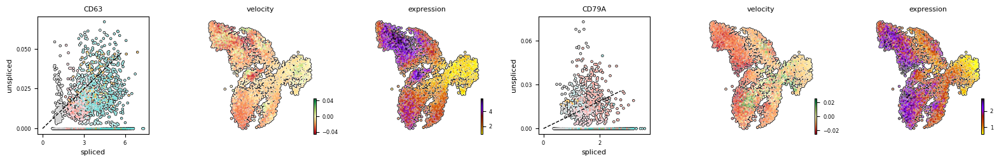

/Users/ycheng/anaconda3/envs/scanpy2/lib/python3.8/site-packages/scvelo/plotting/utils.py:869: MatplotlibDeprecationWarning: The draw_all function was deprecated in Matplotlib 3.6 and will be removed two minor releases later. Use fig.draw_without_rendering() instead.
  cb.draw_all()
/Users/ycheng/anaconda3/envs/scanpy2/lib/python3.8/site-packages/scvelo/plotting/utils.py:869: MatplotlibDeprecationWarning: The draw_all function was deprecated in Matplotlib 3.6 and will be removed two minor releases later. Use fig.draw_without_rendering() instead.
  cb.draw_all()
/Users/ycheng/anaconda3/envs/scanpy2/lib/python3.8/site-packages/scvelo/plotting/utils.py:869: MatplotlibDeprecationWarning: The draw_all function was deprecated in Matplotlib 3.6 and will be removed two minor releases later. Use fig.draw_without_rendering() instead.
  cb.draw_all()
/Users/ycheng/anaconda3/envs/scanpy2/lib/python3.8/site-packages/scvelo/plotting/utils.py:869: MatplotlibDeprecationWarning: The draw_all function w

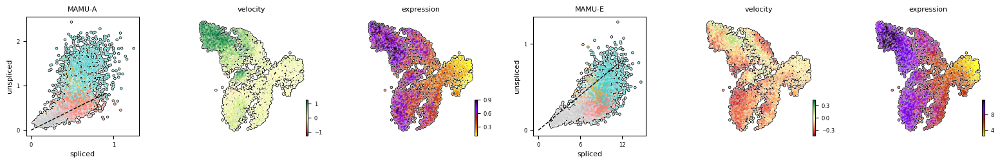

In [86]:
scv.pl.velocity(rnavh, ['SSR4', 'CYBA'], ncols=2,color='phenoclass',add_outline=True
               )
scv.pl.velocity(rnavh, ['CD274','CD59'], ncols=2,color='phenoclass',add_outline=True,)


scv.pl.velocity(rnavh, ['CD63','CD79A'], ncols=2,color='phenoclass',add_outline=True)

scv.pl.velocity(rnavh, ['MAMU-A',  'MAMU-E'], ncols=2,color='phenoclass',add_outline=True
               )






/Users/ycheng/anaconda3/envs/scanpy2/lib/python3.8/site-packages/scvelo/plotting/utils.py:869: MatplotlibDeprecationWarning: The draw_all function was deprecated in Matplotlib 3.6 and will be removed two minor releases later. Use fig.draw_without_rendering() instead.
  cb.draw_all()
/Users/ycheng/anaconda3/envs/scanpy2/lib/python3.8/site-packages/scvelo/plotting/utils.py:869: MatplotlibDeprecationWarning: The draw_all function was deprecated in Matplotlib 3.6 and will be removed two minor releases later. Use fig.draw_without_rendering() instead.
  cb.draw_all()
/Users/ycheng/anaconda3/envs/scanpy2/lib/python3.8/site-packages/scvelo/plotting/utils.py:869: MatplotlibDeprecationWarning: The draw_all function was deprecated in Matplotlib 3.6 and will be removed two minor releases later. Use fig.draw_without_rendering() instead.
  cb.draw_all()
/Users/ycheng/anaconda3/envs/scanpy2/lib/python3.8/site-packages/scvelo/plotting/utils.py:869: MatplotlibDeprecationWarning: The draw_all function w

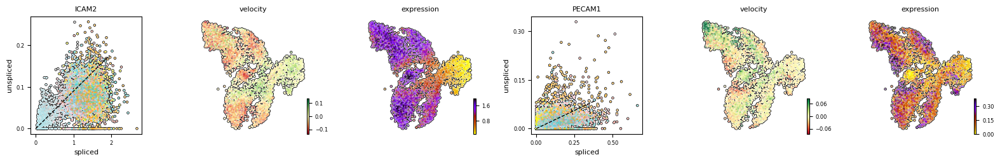

/Users/ycheng/anaconda3/envs/scanpy2/lib/python3.8/site-packages/scvelo/plotting/utils.py:869: MatplotlibDeprecationWarning: The draw_all function was deprecated in Matplotlib 3.6 and will be removed two minor releases later. Use fig.draw_without_rendering() instead.
  cb.draw_all()
/Users/ycheng/anaconda3/envs/scanpy2/lib/python3.8/site-packages/scvelo/plotting/utils.py:869: MatplotlibDeprecationWarning: The draw_all function was deprecated in Matplotlib 3.6 and will be removed two minor releases later. Use fig.draw_without_rendering() instead.
  cb.draw_all()
/Users/ycheng/anaconda3/envs/scanpy2/lib/python3.8/site-packages/scvelo/plotting/utils.py:869: MatplotlibDeprecationWarning: The draw_all function was deprecated in Matplotlib 3.6 and will be removed two minor releases later. Use fig.draw_without_rendering() instead.
  cb.draw_all()
/Users/ycheng/anaconda3/envs/scanpy2/lib/python3.8/site-packages/scvelo/plotting/utils.py:869: MatplotlibDeprecationWarning: The draw_all function w

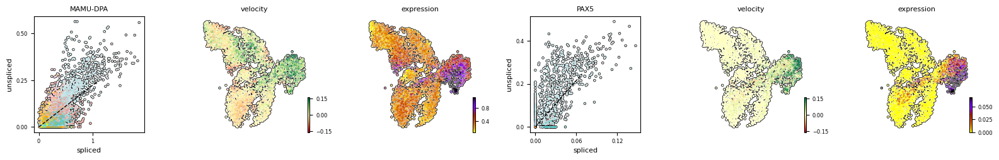

/Users/ycheng/anaconda3/envs/scanpy2/lib/python3.8/site-packages/scvelo/plotting/utils.py:869: MatplotlibDeprecationWarning: The draw_all function was deprecated in Matplotlib 3.6 and will be removed two minor releases later. Use fig.draw_without_rendering() instead.
  cb.draw_all()
/Users/ycheng/anaconda3/envs/scanpy2/lib/python3.8/site-packages/scvelo/plotting/utils.py:869: MatplotlibDeprecationWarning: The draw_all function was deprecated in Matplotlib 3.6 and will be removed two minor releases later. Use fig.draw_without_rendering() instead.
  cb.draw_all()
/Users/ycheng/anaconda3/envs/scanpy2/lib/python3.8/site-packages/scvelo/plotting/utils.py:869: MatplotlibDeprecationWarning: The draw_all function was deprecated in Matplotlib 3.6 and will be removed two minor releases later. Use fig.draw_without_rendering() instead.
  cb.draw_all()
/Users/ycheng/anaconda3/envs/scanpy2/lib/python3.8/site-packages/scvelo/plotting/utils.py:869: MatplotlibDeprecationWarning: The draw_all function w

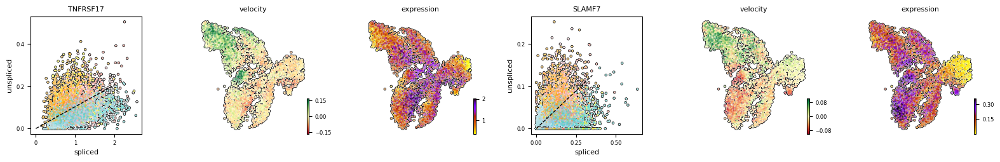

/Users/ycheng/anaconda3/envs/scanpy2/lib/python3.8/site-packages/scvelo/plotting/utils.py:869: MatplotlibDeprecationWarning: The draw_all function was deprecated in Matplotlib 3.6 and will be removed two minor releases later. Use fig.draw_without_rendering() instead.
  cb.draw_all()
/Users/ycheng/anaconda3/envs/scanpy2/lib/python3.8/site-packages/scvelo/plotting/utils.py:869: MatplotlibDeprecationWarning: The draw_all function was deprecated in Matplotlib 3.6 and will be removed two minor releases later. Use fig.draw_without_rendering() instead.
  cb.draw_all()
/Users/ycheng/anaconda3/envs/scanpy2/lib/python3.8/site-packages/scvelo/plotting/utils.py:869: MatplotlibDeprecationWarning: The draw_all function was deprecated in Matplotlib 3.6 and will be removed two minor releases later. Use fig.draw_without_rendering() instead.
  cb.draw_all()
/Users/ycheng/anaconda3/envs/scanpy2/lib/python3.8/site-packages/scvelo/plotting/utils.py:869: MatplotlibDeprecationWarning: The draw_all function w

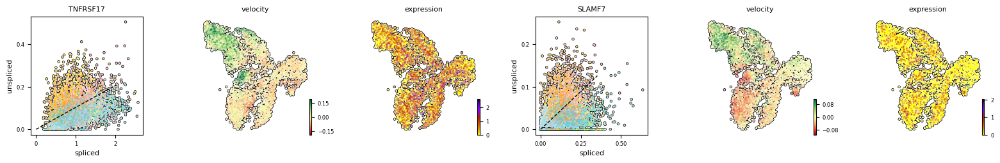

In [701]:
scv.pl.velocity(rnavh, ['ICAM2','PECAM1'], ncols=2,color='leiden',add_outline=True)
scv.pl.velocity(rnavh, ['MAMU-DPA','PAX5'], ncols=2,color='leiden',add_outline=True)
scv.pl.velocity(rnavh, ['TNFRSF17','SLAMF7'], ncols=2,color='leiden',add_outline=True)



scv.pl.velocity(rnavh, ['TNFRSF17','SLAMF7'], ncols=2,color='leiden',add_outline=True,layers=['velocity', 'X'], perc=None)




/Users/ycheng/anaconda3/envs/scanpy2/lib/python3.8/site-packages/scvelo/plotting/utils.py:869: MatplotlibDeprecationWarning: The draw_all function was deprecated in Matplotlib 3.6 and will be removed two minor releases later. Use fig.draw_without_rendering() instead.
  cb.draw_all()
/Users/ycheng/anaconda3/envs/scanpy2/lib/python3.8/site-packages/scvelo/plotting/utils.py:869: MatplotlibDeprecationWarning: The draw_all function was deprecated in Matplotlib 3.6 and will be removed two minor releases later. Use fig.draw_without_rendering() instead.
  cb.draw_all()
/Users/ycheng/anaconda3/envs/scanpy2/lib/python3.8/site-packages/scvelo/plotting/utils.py:869: MatplotlibDeprecationWarning: The draw_all function was deprecated in Matplotlib 3.6 and will be removed two minor releases later. Use fig.draw_without_rendering() instead.
  cb.draw_all()
/Users/ycheng/anaconda3/envs/scanpy2/lib/python3.8/site-packages/scvelo/plotting/utils.py:869: MatplotlibDeprecationWarning: The draw_all function w

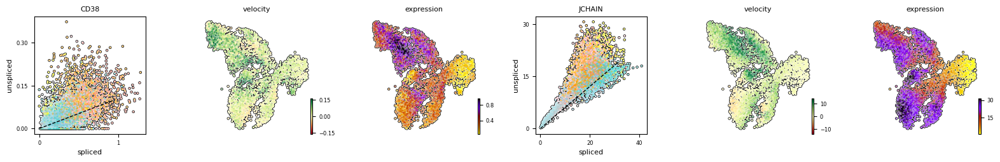

/Users/ycheng/anaconda3/envs/scanpy2/lib/python3.8/site-packages/scvelo/plotting/utils.py:869: MatplotlibDeprecationWarning: The draw_all function was deprecated in Matplotlib 3.6 and will be removed two minor releases later. Use fig.draw_without_rendering() instead.
  cb.draw_all()
/Users/ycheng/anaconda3/envs/scanpy2/lib/python3.8/site-packages/scvelo/plotting/utils.py:869: MatplotlibDeprecationWarning: The draw_all function was deprecated in Matplotlib 3.6 and will be removed two minor releases later. Use fig.draw_without_rendering() instead.
  cb.draw_all()
/Users/ycheng/anaconda3/envs/scanpy2/lib/python3.8/site-packages/scvelo/plotting/utils.py:869: MatplotlibDeprecationWarning: The draw_all function was deprecated in Matplotlib 3.6 and will be removed two minor releases later. Use fig.draw_without_rendering() instead.
  cb.draw_all()
/Users/ycheng/anaconda3/envs/scanpy2/lib/python3.8/site-packages/scvelo/plotting/utils.py:869: MatplotlibDeprecationWarning: The draw_all function w

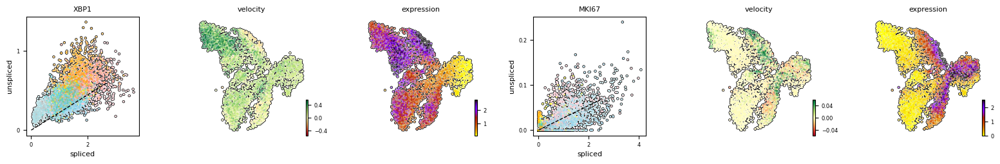

/Users/ycheng/anaconda3/envs/scanpy2/lib/python3.8/site-packages/scvelo/plotting/utils.py:869: MatplotlibDeprecationWarning: The draw_all function was deprecated in Matplotlib 3.6 and will be removed two minor releases later. Use fig.draw_without_rendering() instead.
  cb.draw_all()
/Users/ycheng/anaconda3/envs/scanpy2/lib/python3.8/site-packages/scvelo/plotting/utils.py:869: MatplotlibDeprecationWarning: The draw_all function was deprecated in Matplotlib 3.6 and will be removed two minor releases later. Use fig.draw_without_rendering() instead.
  cb.draw_all()
/Users/ycheng/anaconda3/envs/scanpy2/lib/python3.8/site-packages/scvelo/plotting/utils.py:869: MatplotlibDeprecationWarning: The draw_all function was deprecated in Matplotlib 3.6 and will be removed two minor releases later. Use fig.draw_without_rendering() instead.
  cb.draw_all()
/Users/ycheng/anaconda3/envs/scanpy2/lib/python3.8/site-packages/scvelo/plotting/utils.py:869: MatplotlibDeprecationWarning: The draw_all function w

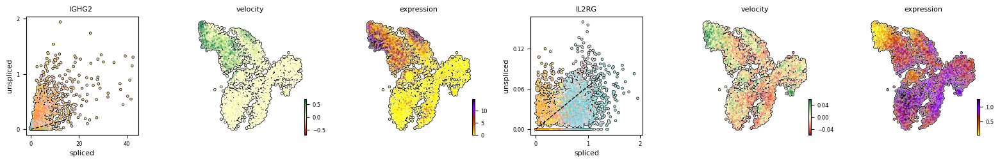

/Users/ycheng/anaconda3/envs/scanpy2/lib/python3.8/site-packages/scvelo/plotting/utils.py:869: MatplotlibDeprecationWarning: The draw_all function was deprecated in Matplotlib 3.6 and will be removed two minor releases later. Use fig.draw_without_rendering() instead.
  cb.draw_all()
/Users/ycheng/anaconda3/envs/scanpy2/lib/python3.8/site-packages/scvelo/plotting/utils.py:869: MatplotlibDeprecationWarning: The draw_all function was deprecated in Matplotlib 3.6 and will be removed two minor releases later. Use fig.draw_without_rendering() instead.
  cb.draw_all()
/Users/ycheng/anaconda3/envs/scanpy2/lib/python3.8/site-packages/scvelo/plotting/utils.py:869: MatplotlibDeprecationWarning: The draw_all function was deprecated in Matplotlib 3.6 and will be removed two minor releases later. Use fig.draw_without_rendering() instead.
  cb.draw_all()
/Users/ycheng/anaconda3/envs/scanpy2/lib/python3.8/site-packages/scvelo/plotting/utils.py:869: MatplotlibDeprecationWarning: The draw_all function w

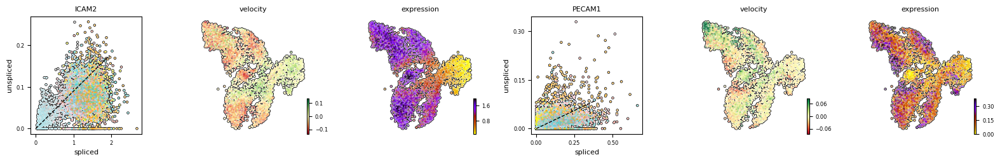

In [711]:
scv.pl.velocity(rnavh, ['CD38','JCHAIN'], ncols=2,color='leiden',add_outline=True)
scv.pl.velocity(rnavh, ['XBP1','MKI67',], ncols=2,color='leiden',add_outline=True)

scv.pl.velocity(rnavh, ['IGHG2 ','IL2RG'], ncols=2,color='leiden',add_outline=True)

scv.pl.velocity(rnavh, ['ICAM2','PECAM1'], ncols=2,color='leiden',add_outline=True)




--> added 'velocity_length' (adata.obs)
--> added 'velocity_confidence' (adata.obs)
--> added 'velocity_confidence_transition' (adata.obs)


/Users/ycheng/anaconda3/envs/scanpy2/lib/python3.8/site-packages/scvelo/plotting/utils.py:869: MatplotlibDeprecationWarning: The draw_all function was deprecated in Matplotlib 3.6 and will be removed two minor releases later. Use fig.draw_without_rendering() instead.
  cb.draw_all()
/Users/ycheng/anaconda3/envs/scanpy2/lib/python3.8/site-packages/scvelo/plotting/utils.py:869: MatplotlibDeprecationWarning: The draw_all function was deprecated in Matplotlib 3.6 and will be removed two minor releases later. Use fig.draw_without_rendering() instead.
  cb.draw_all()


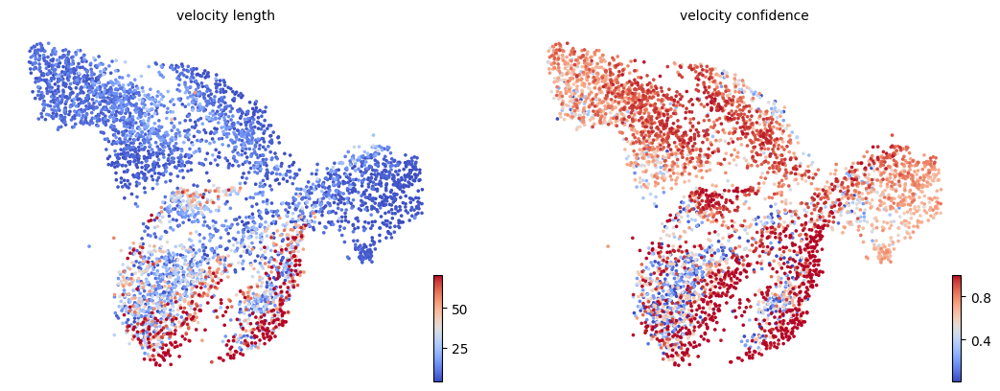

In [165]:

scv.tl.velocity_confidence(rnavh)
keys = 'velocity_length', 'velocity_confidence'
scv.pl.scatter(rnavh, c=keys, cmap='coolwarm', perc=[5, 95])

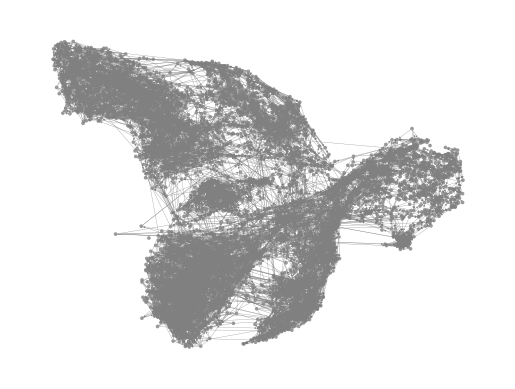

In [166]:
scv.pl.velocity_graph(rnavh, threshold=.3,arrows=True )


/Users/ycheng/anaconda3/envs/scanpy2/lib/python3.8/site-packages/scvelo/plotting/utils.py:869: MatplotlibDeprecationWarning: The draw_all function was deprecated in Matplotlib 3.6 and will be removed two minor releases later. Use fig.draw_without_rendering() instead.
  cb.draw_all()


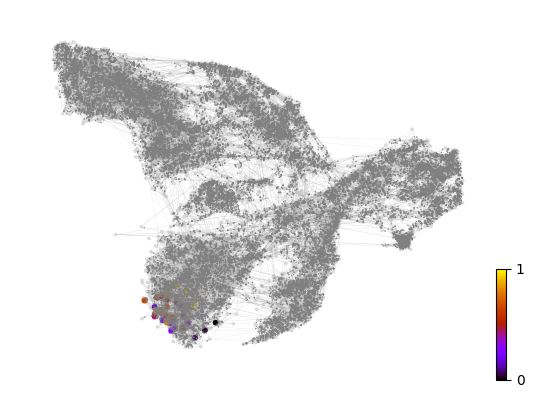

In [167]:
x, y = scv.utils.get_cell_transitions(rnavh, basis='umap', starting_cell=70)
ax = scv.pl.velocity_graph(rnavh, arrows=True, c='lightgrey', edge_width=.05, show=False)
ax = scv.pl.scatter(rnavh, x=x, y=y, s=70, c='ascending', cmap='gnuplot', ax=ax)

In [210]:
# this is needed due to a current bug - bugfix is coming soon.
rnavh.uns['neighbors']['distances'] = rnavh.obsp['distances']
rnavh.uns['neighbors']['connectivities'] = rnavh.obsp['connectivities']

scv.tl.paga(rnavh, groups='phenoclass')
df = scv.get_df(rnavh, 'paga/transitions_confidence', precision=2).T
# df.style.background_gradient(cmap='Blues').format('{:.2g}')

running PAGA using priors: ['velocity_pseudotime']
    finished (0:00:00) --> added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns)
    'paga/transitions_confidence', velocity transitions (adata.uns)


In [592]:
scv.tl.paga(rnavh, groups='phenoclass')
df = scv.get_df(rnavh, 'paga/transitions_confidence', precision=3).T

running PAGA using priors: ['velocity_pseudotime']
    finished (0:00:00) --> added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns)
    'paga/transitions_confidence', velocity transitions (adata.uns)


In [593]:
df

,ActB,aPC,gPB,gPC,mPB,mPC,prePB
ActB,0.0,0.000,0.000,0.000,0.000,0.000,0.492
aPC,0.0,0.000,0.000,0.000,0.000,0.000,0.000
gPB,0.0,0.051,0.000,0.552,0.000,0.000,0.000
gPC,0.0,0.000,0.000,0.000,0.000,0.000,0.000
mPB,0.0,0.000,0.117,0.000,0.000,0.000,0.000
mPC,0.0,0.000,0.000,0.000,0.000,0.000,0.000
prePB,0.0,0.000,0.000,0.000,0.393,0.495,0.000


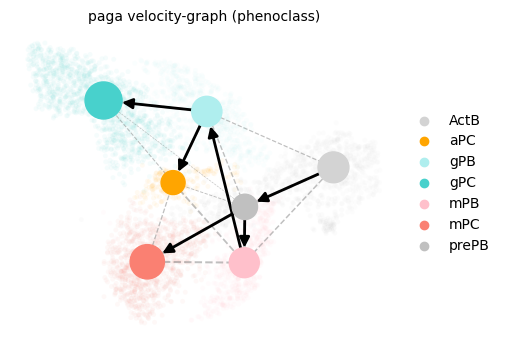

In [609]:
scv.pl.paga(rnavh, basis='umap', size=50, alpha=.05,
            min_edge_width=2, node_size_scale=3,color='phenoclass',figsize=[5,4],edge_width_scale=0.9)

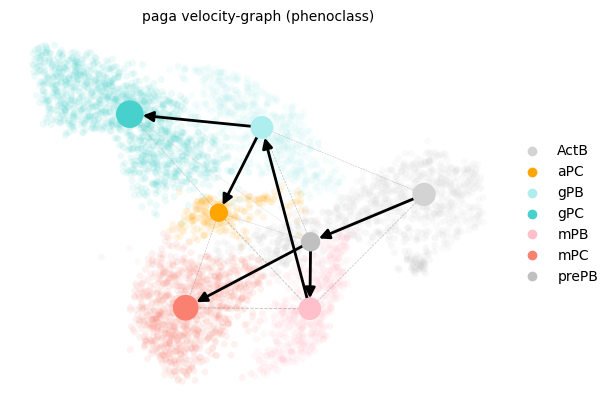

In [594]:
scv.pl.paga(rnavh, basis='umap', size=100, alpha=.1,
            min_edge_width=2, node_size_scale=1.5,color='phenoclass')

In [236]:
rnavh.obs.columns

Index(['sample_batch', 'initial_size_unspliced', 'initial_size_spliced',
       'initial_size', 'donor', 'batch', 'n_genes', 'n_genes_by_counts',
       'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden',
       'leiden_ex', 'class', 'IgH', 'phenoclass', 'pheno', 'n_counts',
       'velocity_self_transition', 'root_cells', 'end_points',
       'velocity_pseudotime'],
      dtype='object')

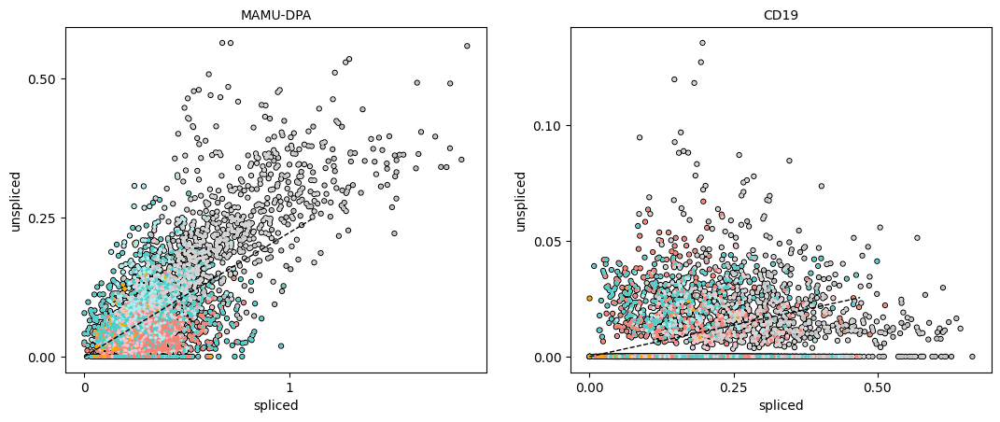

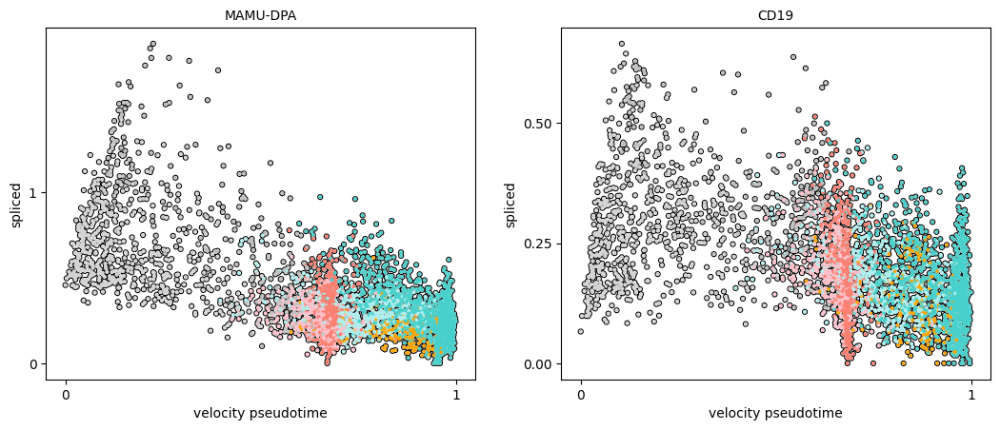

In [91]:
var_names = ['CD59','CD274','CD63','CD79A']
var_names = ['MAMU-DPA','CD19']


scv.pl.scatter(rnavh, var_names, color='phenoclass',add_outline=True)
scv.pl.scatter(rnavh, x='velocity_pseudotime', y=var_names, color='phenoclass',add_outline=True)



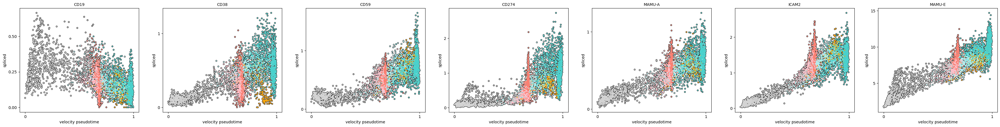

In [85]:
var_names = ['CD19','CD38','CD59','CD274','MAMU-A','ICAM2','MAMU-E']
# scv.pl.scatter(rnavh, var_names, color='phenoclass',add_outline=True)
scv.pl.scatter(rnavh, x='velocity_pseudotime', y=var_names, color='phenoclass',add_outline=True)

In [196]:
t=[0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7,0.8,0.9,1]
conditions = [

    (rnavh.obs['velocity_pseudotime'] >= t[0]) & (rnavh.obs['velocity_pseudotime'] <= t[1]),
    (rnavh.obs['velocity_pseudotime'] > t[1]) & (rnavh.obs['velocity_pseudotime'] <= t[2]), 
    (rnavh.obs['velocity_pseudotime'] >t[2]) & (rnavh.obs['velocity_pseudotime'] <= t[3]),
    (rnavh.obs['velocity_pseudotime'] > t[3]) & (rnavh.obs['velocity_pseudotime'] <= t[4]),
    (rnavh.obs['velocity_pseudotime'] > t[4]) & (rnavh.obs['velocity_pseudotime'] <= t[5]),
     (rnavh.obs['velocity_pseudotime'] > t[5]) & (rnavh.obs['velocity_pseudotime'] <= t[6]),
    (rnavh.obs['velocity_pseudotime'] > t[6]) & (rnavh.obs['velocity_pseudotime'] <= t[7]),
     (rnavh.obs['velocity_pseudotime'] > t[7]) & (rnavh.obs['velocity_pseudotime'] <= t[8]),
     (rnavh.obs['velocity_pseudotime'] > t[8]) & (rnavh.obs['velocity_pseudotime'] <= t[9]),
    (rnavh.obs['velocity_pseudotime'] > t[9]) & (rnavh.obs['velocity_pseudotime'] <= t[10]),


]


    

# create a list of the values we want to assign for each condition
values = ['t0','t1','t2','t3','t4','t5','t6','t7','t8','t9']

# create a new column and use np.select to assign values to it using our lists as arguments

rnavh.obs['time'] = np.select(conditions, values)



In [354]:
np.around(np.arange (0,1,0.05),2).tolist()

[0.0,
 0.05,
 0.1,
 0.15,
 0.2,
 0.25,
 0.3,
 0.35,
 0.4,
 0.45,
 0.5,
 0.55,
 0.6,
 0.65,
 0.7,
 0.75,
 0.8,
 0.85,
 0.9,
 0.95]

In [355]:
def making_interval_mean(data,var, interval,var_out):
    conditions=[]
    for i in np.arange (0,1,interval):      
         conditions.append((data.obs[var] >= i) & (data.obs[var] <= i+interval))
#     values=[]
#     for i in range(len(conditions)):
#         exec("values.append('t" + str(i) +"')")
    values= np.around(np.arange (0,1,interval),2).tolist()
    data.obs[var_out] = np.select(conditions, values)




            

In [454]:
making_interval_mean(rnavh,'velocity_pseudotime', 0.1,'time0.1')

In [455]:
rnavh.obs

,sample_batch,initial_size_unspliced,initial_size_spliced,initial_size,donor,batch,n_genes,n_genes_by_counts,total_counts,total_counts_mt,...,pheno,n_counts,velocity_self_transition,root_cells,end_points,velocity_pseudotime,time,time0.1,time0.05,time0.025
AAACCCAGTGAC-0,TGTT-1,1541,10030,10030.0,633,0,3398,3398,14457.0,141.0,...,PB,1742.721191,0.433540,0.001894,0.001592,0.664227,t6,0.6,0.65,0.65
AAACGCTAGCCG-0,AACA-1,877,5088,5088.0,633,0,1816,1816,7158.0,122.0,...,PC,1223.771240,0.425448,0.000091,0.485052,0.868537,t8,0.8,0.85,0.85
AAAGAACAGCGC-0,TGCT-1,966,4398,4398.0,633,0,1703,1703,6744.0,66.0,...,PC,1160.567139,0.000000,0.000253,0.122865,0.683343,t6,0.6,0.65,0.68
AAAGAACCACCA-0,GGTC-1,1101,2051,2051.0,633,0,1782,1782,5071.0,66.0,...,PC,1428.021362,0.137058,0.000744,0.279746,0.673316,t6,0.6,0.65,0.65
AAAGGATGTCTT-0,CAAG-1,1097,7283,7283.0,633,0,2847,2847,10406.0,158.0,...,PB,1716.000244,0.404481,0.001478,0.001646,0.661616,t6,0.6,0.65,0.65
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGGTTCAACA-1,CGAG-1,2015,6858,6858.0,669,1,3989,3989,11561.0,222.0,...,ActB,2304.861816,0.420126,0.182974,0.000015,0.083926,t0,0.0,0.05,0.08
TTTGTTGGTGGT-1,GATG-1,474,1794,1794.0,669,1,1092,1092,2773.0,76.0,...,PC,1213.700928,0.266646,0.001869,0.088586,0.849829,t8,0.8,0.80,0.82
TTTGTTGGTTCA-1,TCGA-1,944,2737,2737.0,669,1,1978,1978,4580.0,88.0,...,PC,1688.888550,0.168470,0.000680,0.259184,0.641747,t6,0.6,0.60,0.62
TTTGTTGTCCTT-1,ATAC-1,630,3600,3600.0,669,1,1607,1607,5262.0,38.0,...,PC,1281.778198,0.574452,0.000014,0.706006,0.881274,t8,0.8,0.85,0.88


In [484]:
from scipy.interpolate import make_interp_spline


def calculate_xy(data,varx,vary,smooth):
    t=np.sort(np.unique(data[varx]))
    tarr=[]
    for i in t:
        tarr=np.append(tarr,np.mean(data[data[varx]==i][vary]))
    x=np.array(t)
    y=tarr
    #smoothing
    X_Y_Spline = make_interp_spline(x, y)
 
    # Returns evenly spaced numbers
    # over a specified interval.
    X_ = np.linspace(x.min(), x.max(), smooth)
    Y_ = X_Y_Spline(X_)
 
    # Plotting the Graph
    fig=plt.figure(figsize=(3,1))
    plt.plot(X_, Y_,'-ok',linewidth=2,alpha=0.3)
    


In [ ]:
print ()

In [552]:
dic={'pseudotime':rnavh.obs['velocity_pseudotime'],
    'time':rnavh.obs['time0.1'],
     'phen':rnavh.obs['phenoclass']}
key=['CD274','CD59','MAMU-A','MAMU-E','HLA, B-38 ACHAIN_2','CD38','ICAM2','CD63','CYBA','PAX5','IRF4','XBP1',
     'PRDM1','MAMU-DPA','TMBIM6','SLAMF7','AICDA','BIRC3','EZH2','BANK1','PECAM1','MZB1','SSR4','HLA, B-15 ACHAIN']
    
for i in key:
    new={i:rnavh.obs_vector(i)}
#     print (new)
    dic.update(new)

data=pd.DataFrame.from_dict(dic)



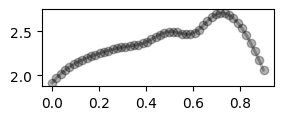

In [553]:
calculate_xy(data,'time','HLA, B-15 ACHAIN',50)



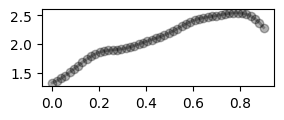

In [485]:
calculate_xy(data,'time','MAMU-A',50)


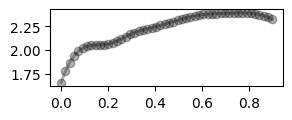

In [486]:
calculate_xy(data,'time','MAMU-E',50)



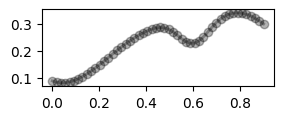

In [487]:
calculate_xy(data,'time','CD38',50)



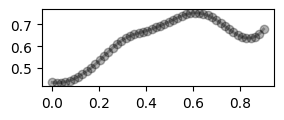

In [488]:
calculate_xy(data,'time','CD79A',50)



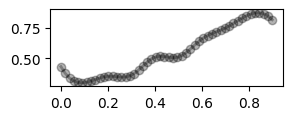

In [489]:
calculate_xy(data,'time','CD59',50)


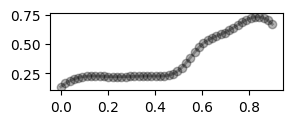

In [490]:
calculate_xy(data,'time','CD274',50)



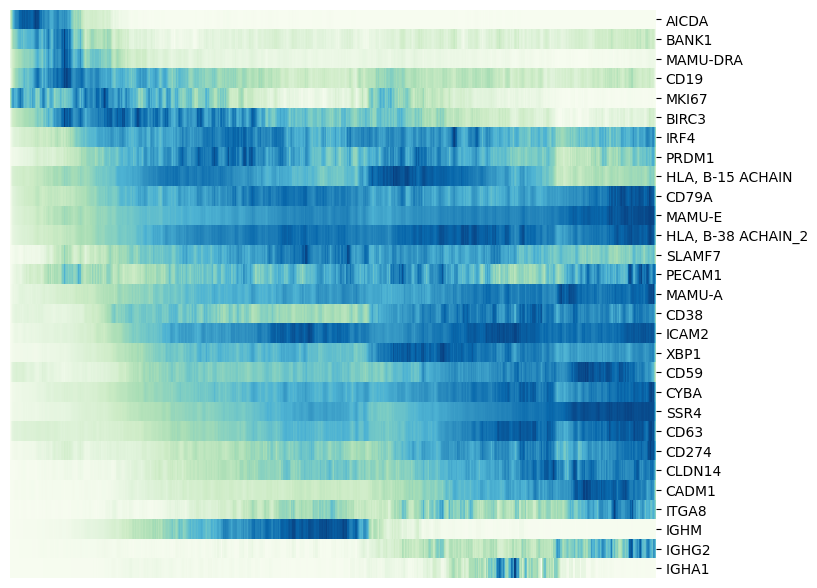

In [46]:
scv.pl.heatmap(rnavh,['AICDA','BANK1','MAMU-DRA','CD19','MKI67','BIRC3','IRF4','PRDM1','HLA, B-15 ACHAIN','CD79A','MAMU-E','HLA, BCHAIN','HLA, B-38 ACHAIN_1','HLA, B-38 ACHAIN_2','HLA, B-38 ACHAIN','SLAMF7','PECAM1','MAMU-A','HLA-G','CD38','ICAM2','XBP1','CD59','CYBA','SSR4','CD63','CD274','CLDN14','CADM1','ITGA8','IGHM','IGHG2 ','IGHA1 ',], 
               sortby='velocity_pseudotime',color_map='GnBu',sort=False,figsize=(8.28 ,6), colorbar=True)

In [314]:
rnavh.obs

,sample_batch,initial_size_unspliced,initial_size_spliced,initial_size,donor,batch,n_genes,n_genes_by_counts,total_counts,total_counts_mt,...,leiden_ex,class,IgH,phenoclass,pheno,n_counts,velocity_self_transition,root_cells,end_points,velocity_pseudotime
AAACCCAGTGAC-0,TGTT-1,1541,10030,10030.0,633,0,3398,3398,14457.0,141.0,...,8,G,K,gPB,PB,1742.72,0.43,1.89e-03,1.59e-03,0.66
AAACGCTAGCCG-0,AACA-1,877,5088,5088.0,633,0,1816,1816,7158.0,122.0,...,1,G,K,gPC,PC,1223.77,0.43,9.11e-05,4.85e-01,0.87
AAAGAACAGCGC-0,TGCT-1,966,4398,4398.0,633,0,1703,1703,6744.0,66.0,...,3,M,L,mPC,PC,1160.57,0.00,2.53e-04,1.23e-01,0.68
AAAGAACCACCA-0,GGTC-1,1101,2051,2051.0,633,0,1782,1782,5071.0,66.0,...,3,M,L,mPC,PC,1428.02,0.14,7.44e-04,2.80e-01,0.67
AAAGGATGTCTT-0,CAAG-1,1097,7283,7283.0,633,0,2847,2847,10406.0,158.0,...,8,G,K,gPB,PB,1716.00,0.40,1.48e-03,1.65e-03,0.66
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGGTTCAACA-1,CGAG-1,2015,6858,6858.0,669,1,3989,3989,11561.0,222.0,...,2,x,x,ActB,ActB,2304.86,0.42,1.83e-01,1.47e-05,0.08
TTTGTTGGTGGT-1,GATG-1,474,1794,1794.0,669,1,1092,1092,2773.0,76.0,...,10,A,K,aPC,PC,1213.70,0.27,1.87e-03,8.86e-02,0.85
TTTGTTGGTTCA-1,TCGA-1,944,2737,2737.0,669,1,1978,1978,4580.0,88.0,...,3,M,L,mPC,PC,1688.89,0.17,6.80e-04,2.59e-01,0.64
TTTGTTGTCCTT-1,ATAC-1,630,3600,3600.0,669,1,1607,1607,5262.0,38.0,...,1,G,K,gPC,PC,1281.78,0.57,1.36e-05,7.06e-01,0.88


In [299]:
# rnavl.write('rnavl.h5')

In [300]:
# rnavh.write('rnavh.h5')

In [253]:
rnavl=rnann.copy()

In [254]:
scv.pp.filter_and_normalize(rnavl, min_shared_counts=20, n_top_genes=10000)
scv.pp.moments(rnavl, n_pcs=15, n_neighbors=40)

Filtered out 12691 genes that are detected 20 counts (shared).
Normalized count data: spliced, unspliced.
Skip filtering by dispersion since number of variables are less than `n_top_genes`.
computing neighbors
    finished (0:00:00) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:01) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)


In [255]:
scv.tl.velocity(rnavl)
scv.tl.velocity_graph(rnavl)

computing velocities
    finished (0:00:01) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph (using 1/8 cores)


  0%|          | 0/4319 [00:00<?, ?cells/s]

    finished (0:00:12) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


/Users/ycheng/anaconda3/envs/scanpy2/lib/python3.8/site-packages/scvelo/plotting/utils.py:869: MatplotlibDeprecationWarning: The draw_all function was deprecated in Matplotlib 3.6 and will be removed two minor releases later. Use fig.draw_without_rendering() instead.
  cb.draw_all()


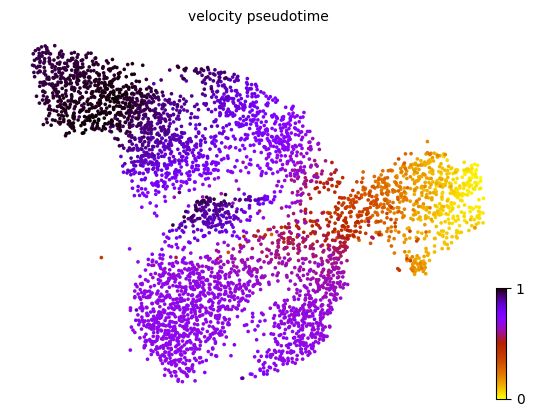

In [387]:
scv.tl.velocity_pseudotime(rnavl)

scv.pl.scatter(rnavl, color='velocity_pseudotime', cmap='gnuplot_r')



recovering dynamics (using 1/8 cores)
    finished (0:00:03) --> added 
    'fit_pars', fitted parameters for splicing dynamics (adata.var)
testing for differential kinetics
    finished (0:00:00) --> added 
    'fit_diff_kinetics', clusters displaying differential kinetics (adata.var)
    'fit_pvals_kinetics', p-values of differential kinetics (adata.var)


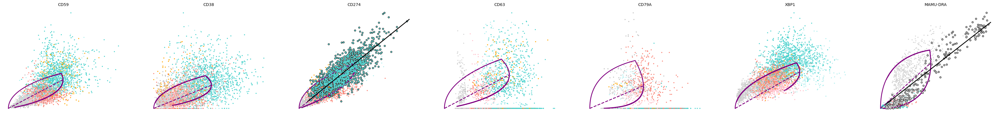

In [257]:
var_names = ['CD59','CD38','CD274','CD63','CD79A','XBP1','MAMU-DRA']
scv.tl.differential_kinetic_test(rnavl, var_names=var_names, groupby='phenoclass')
kwargs = dict(linewidth=2, add_linfit=True, frameon=False)
scv.pl.scatter(rnavl, basis=var_names, add_outline='fit_diff_kinetics', **kwargs)

In [467]:
rnavh.var_names[rnavh.var_names.str.startswith('HLA')]

Index(['HLA, B-15 ACHAIN', 'HLA, B-38 ACHAIN_2'], dtype='object')

In [259]:
scv.get_df(rnavl[:, var_names], ['fit_diff_kinetics', 'fit_pval_kinetics'], precision=2)


,fit_diff_kinetics,fit_pval_kinetics
CD274,gPC,2.30e-06
MAMU-DRA,prePB,4.12e-17


In [258]:

top_genes = rnavl.var['fit_likelihood'].sort_values(ascending=False).index[:300]
scv.pl.heatmap(rnavl, var_names=top_genes, sortby='latent_time', col_color='leiden', n_convolve=100)

KeyError: 'latent_time'

In [265]:
scv.tl.recover_dynamics(rnavl)


recovering dynamics (using 1/8 cores)


  0%|          | 0/835 [00:00<?, ?gene/s]

    finished (0:04:41) --> added 
    'fit_pars', fitted parameters for splicing dynamics (adata.var)


In [266]:
top_genes = rnavl.var['fit_likelihood'].sort_values(ascending=False).index[:100]
scv.tl.differential_kinetic_test(rnavl, var_names=top_genes, groupby='phenoclass')

testing for differential kinetics
    finished (0:00:12) --> added 
    'fit_diff_kinetics', clusters displaying differential kinetics (adata.var)
    'fit_pvals_kinetics', p-values of differential kinetics (adata.var)


In [376]:
rnavl.var['fit_likelihood'].sort_values(ascending=False)[0:50]

IGHM                         0.82
KYNU                         0.57
MGLL                         0.55
BATF3                        0.47
DIAPH3                       0.45
IGF1                         0.44
DERL3                        0.44
CDCA7                        0.43
NON-FUNCTIONAL IGKV6D-41     0.42
SMC4                         0.42
RNASEH2B                     0.41
TUBA1A                       0.41
CD274                        0.39
SMC2                         0.39
FBXO5                        0.38
NDC80                        0.38
ENO1                         0.37
UVRAG                        0.37
TALDO1                       0.37
EZH2                         0.36
CUL3                         0.36
TOX2                         0.36
JCHAIN                       0.36
TMPO                         0.36
HERPUD1                      0.36
FUT8                         0.35
RPS12                        0.35
BIRC3                        0.35
KHDRBS3                      0.35
CHD1          

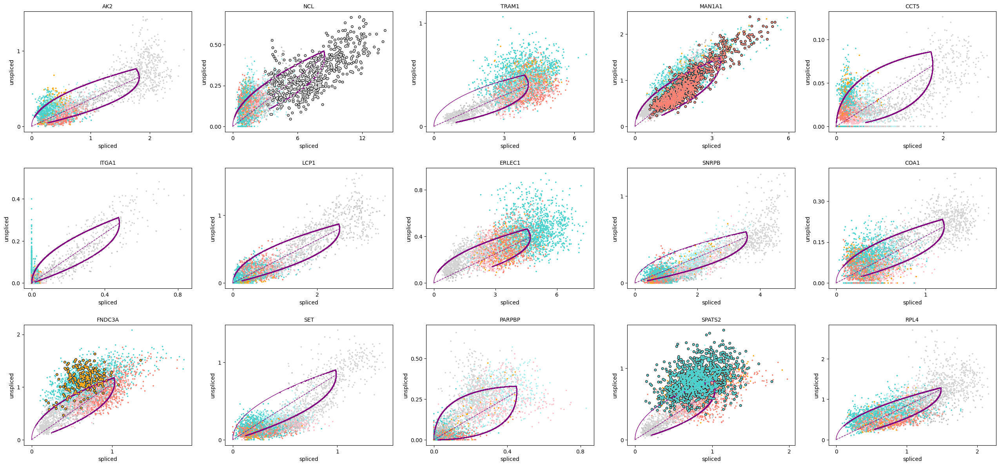

In [381]:
scv.pl.scatter(rnavl, basis=top_genes[30:45], ncols=5, add_outline='fit_diff_kinetics', )


In [382]:
var_names=['EZH2','TUBA1A','BIRC3','MAN1A1','FUT8','FNDC3A','IGF1','CD274']

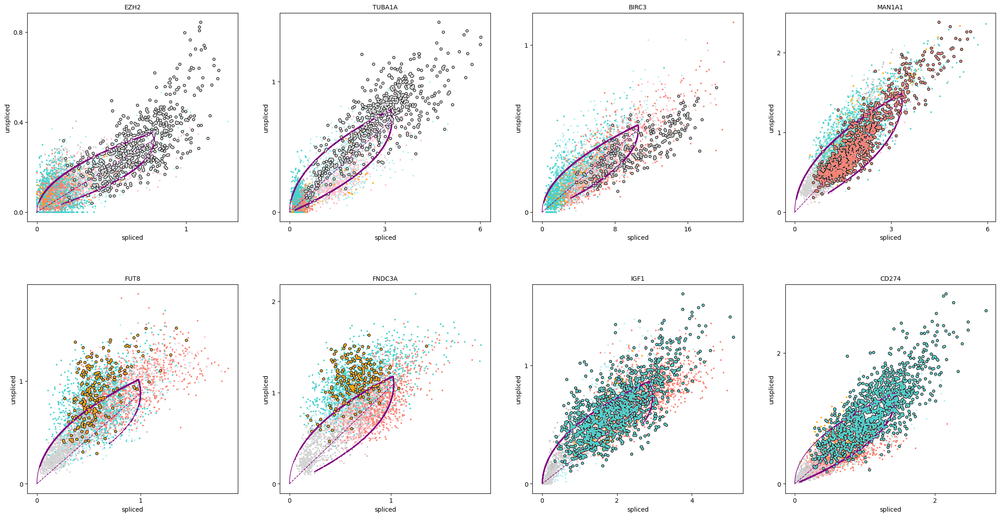

In [385]:
scv.pl.scatter(rnavl, basis=var_names, ncols=4, add_outline='fit_diff_kinetics',figsize=[7,7])



In [386]:
# var_names=['CD38','CD274','CD59','CD79A','CD63']
scv.get_df(rnavl[:, var_names], ['fit_diff_kinetics', 'fit_pval_kinetics'], precision=2)



,fit_diff_kinetics,fit_pval_kinetics
EZH2,ActB,1.70e-08
TUBA1A,ActB,1.97e-06
BIRC3,prePB,1.08e-03
MAN1A1,mPC,1.56e-04
FUT8,aPC,8.95e-03
FNDC3A,aPC,6.73e-04
IGF1,gPC,3.10e-03
CD274,gPC,2.30e-06


In [373]:
rnavl[:, 'CD274'].var['fit_diff_kinetics']

CD274    gPC
Name: fit_diff_kinetics, dtype: category
Categories (1, object): ['gPC']

In [365]:
rnavl.var[rnavl.var.index.str.startswith("CD")]['fit_likelihood'].sort_values(ascending=False)[:20]

CDCA7       0.43
CD274       0.39
CDCA2       0.30
CD70        0.30
CD58        0.29
CDC42       0.28
CDC45       0.27
CD302       0.27
CDK1        0.26
CD80        0.25
CD63        0.25
CDCA3       0.25
CD38        0.25
CD59        0.25
CDKN3       0.24
CD109       0.24
CDK5RAP2    0.22
CD200       0.22
CD47        0.22
CDCA8       0.21
Name: fit_likelihood, dtype: float64

In [617]:
# rnavl.write('rnavl.h5')

In [ ]:
#DEG analysis

In [643]:
rnah.uns['log1p']["base"] = None



In [644]:
rnah.obs

,sample_batch,initial_size_unspliced,initial_size_spliced,initial_size,donor,batch,n_genes,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,leiden,leiden_ex,class,IgH,phenoclass,pheno
AAACCCAGTGAC-0,TGTT-1,1541,10030,10030.0,633,0,3398,3398,14457.0,141.0,0.975,4,8,G,K,gPB,PB
AAACGCTAGCCG-0,AACA-1,877,5088,5088.0,633,0,1816,1816,7158.0,122.0,1.704,7,1,G,K,gPC,PC
AAACGCTGTACT-0,TGTG-1,1184,1992,1992.0,633,0,1691,1691,3941.0,110.0,2.791,3,0,M,K,hMT,hMT
AAAGAACAGCGC-0,TGCT-1,966,4398,4398.0,633,0,1703,1703,6744.0,66.0,0.979,0,3,M,L,mPC,PC
AAAGAACCACCA-0,GGTC-1,1101,2051,2051.0,633,0,1782,1782,5071.0,66.0,1.302,0,3,M,L,mPC,PC
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTTGGTGGT-1,GATG-1,474,1794,1794.0,669,1,1092,1092,2773.0,76.0,2.741,9,10,A,K,aPC,PC
TTTGTTGGTTCA-1,TCGA-1,944,2737,2737.0,669,1,1978,1978,4580.0,88.0,1.921,0,3,M,L,mPC,PC
TTTGTTGTCCTT-1,ATAC-1,630,3600,3600.0,669,1,1607,1607,5262.0,38.0,0.722,7,1,G,K,gPC,PC
TTTGTTGTCTCT-1,CCGA-1,547,2805,2805.0,669,1,1615,1615,4179.0,75.0,1.795,7,1,G,K,gPC,PC


In [645]:
rnah.obs['diff'] = (
    rnah.obs["pheno"]
    .map(lambda x: {'ActB':'B',
    'prePB':'B',
    'PB':'PBC',
    'PC':'PBC'}.get(x, x))
    .astype("category")
)

In [646]:
rnah.obs['diff']


AAACCCAGTGAC-0    PBC
AAACGCTAGCCG-0    PBC
AAACGCTGTACT-0    hMT
AAAGAACAGCGC-0    PBC
AAAGAACCACCA-0    PBC
                 ... 
TTTGTTGGTGGT-1    PBC
TTTGTTGGTTCA-1    PBC
TTTGTTGTCCTT-1    PBC
TTTGTTGTCTCT-1    PBC
TTTGTTGTCTTG-1    hMT
Name: diff, Length: 5568, dtype: category
Categories (5, object): ['B', 'PBC', 'amb', 'hMT', 'lo']

In [781]:
diff=rnah[(rnah.obs['diff']=='B')|(rnah.obs['diff']=='PBC')]

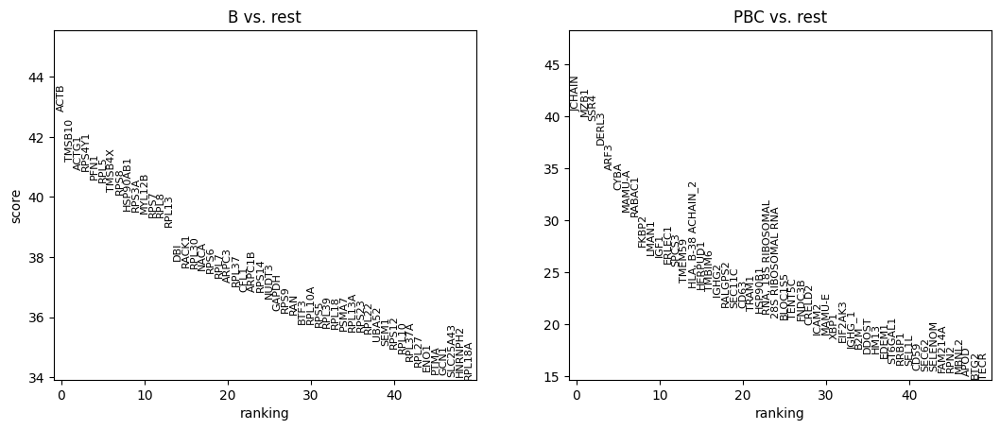

In [782]:
sc.tl.rank_genes_groups(diff, 'diff', method='wilcoxon')
sc.pl.rank_genes_groups(diff, n_genes=50, sharey=False)

In [99]:
pbpc=rnah[(rnah.obs.pheno=='PB')|(rnah.obs.pheno=='PC')]
n633=rnah[rnah.obs.donor=='633']
n669=rnah[rnah.obs.donor=='669']

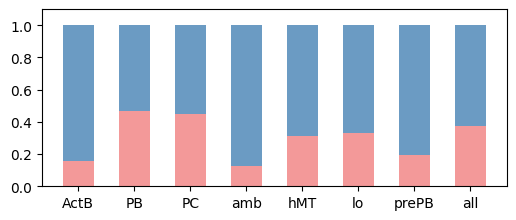

pheno,ActB,PB,PC,amb,hMT,lo,prePB,all
donor,,,,,,,,
633,0.154104,0.469557,0.450359,0.123457,0.315118,0.328571,0.191882,0.376796
669,0.845896,0.530443,0.549641,0.876543,0.684882,0.671429,0.808118,0.623204


In [100]:
d=rnah.obs
dd=d.groupby('pheno')['donor'].value_counts(normalize=True).unstack('pheno')
al=d['donor'].value_counts(normalize=True)
dd['all']= al

labels = dd.columns

donora = dd.iloc[0]
donorb = dd.iloc[1]





fig = plt.figure(figsize=(6,2.3))
ax = fig.add_subplot(111)
width = 0.55       # the width of the bars: can also be len(x) sequence

ax.bar(labels, donora, width,color='lightcoral',alpha=0.8)
ax.bar(labels, donorb, width, bottom=donora,color='steelblue',alpha=0.8)





plt.ylim(0,1.1)

plt.savefig('gbar.pdf')
# plt.legend(loc='upper right')
plt.show()
dd

In [101]:
gpbpc=pbpc[pbpc.obs.phenoclass.str.contains('g')]
mpbpc=pbpc[pbpc.obs.phenoclass.str.contains('m')]

In [102]:
GM=pbpc[(pbpc.obs['class']=='G')|(pbpc.obs['class']=='M')]

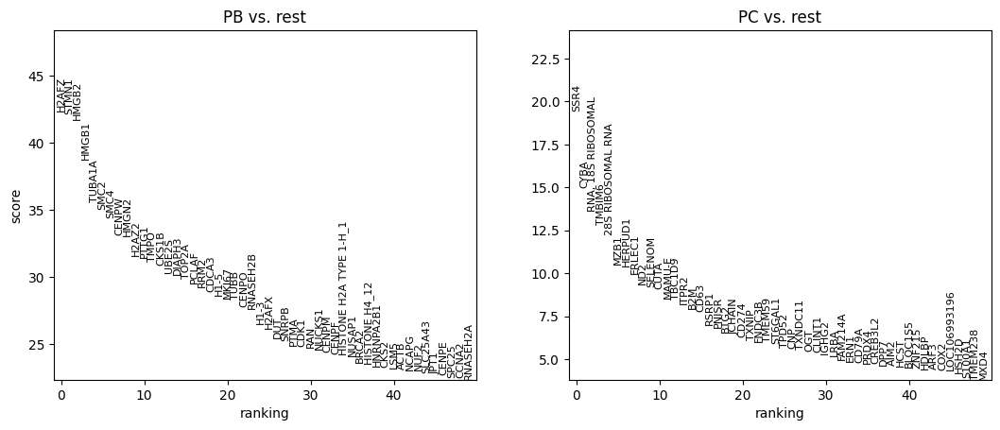

In [14]:
sc.tl.rank_genes_groups(pbpc, 'pheno', method='wilcoxon')
sc.pl.rank_genes_groups(pbpc, n_genes=50, sharey=False)

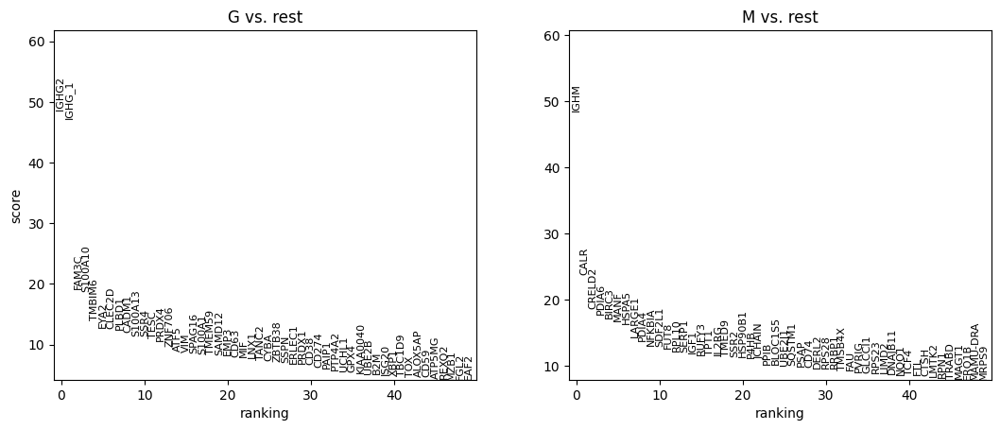

In [705]:
sc.tl.rank_genes_groups(GM, 'class', method='wilcoxon')
sc.pl.rank_genes_groups(GM, n_genes=50, sharey=False)

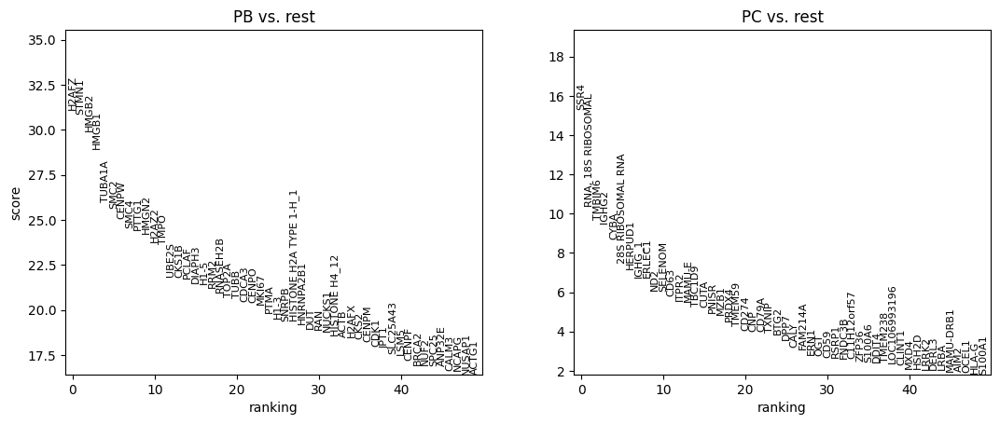

In [651]:
sc.tl.rank_genes_groups(gpbpc, 'pheno', method='wilcoxon')
sc.pl.rank_genes_groups(gpbpc, n_genes=50, sharey=False)

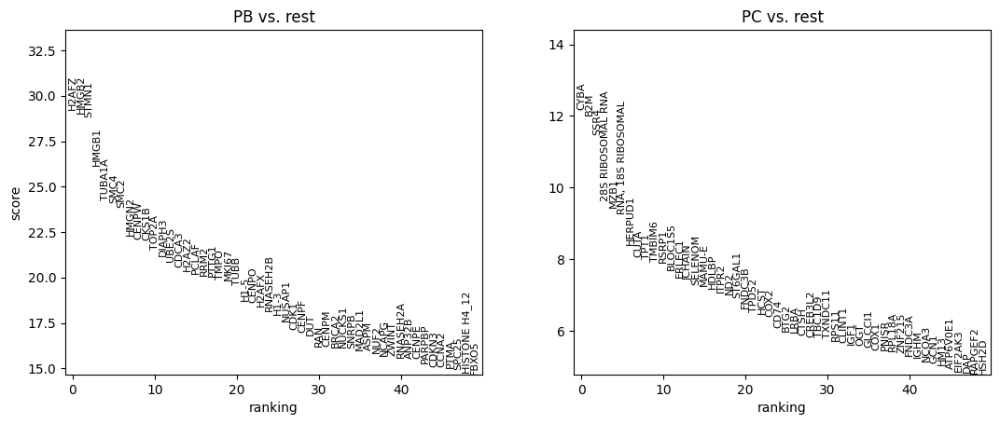

In [652]:
sc.tl.rank_genes_groups(mpbpc, 'pheno', method='wilcoxon')
sc.pl.rank_genes_groups(mpbpc, n_genes=50, sharey=False)

In [783]:
def df_rank_genes_groups(data, group, pval_cutoff : float= None, logfc_cutoff =None):
    df = pd.DataFrame() 
    for k in ['scores', 'names', 'logfoldchanges', 'pvals', 'pvals_adj']: 
        df[k] = data.uns["rank_genes_groups"][k][group] 
    if pval_cutoff is not None: 
        df = df[df["pvals_adj"] < pval_cutoff] 
    if logfc_cutoff is not None: 
        df = df[df["logfoldchanges"].abs() > logfc_cutoff] 


    return df

In [784]:
bpbc=df_rank_genes_groups(diff,'PBC',)
bpbc['-logp']=-np.log10(bpbc['pvals_adj'])





In [709]:
Gpbpc=df_rank_genes_groups(GM,'G',)
Mpbpc=df_rank_genes_groups(GM,'M',)

Gpbpc['-logp']=-np.log10(Gpbpc['pvals_adj'])
Mpbpc['-logp']=-np.log10(Mpbpc['pvals_adj'])





In [710]:
Gpbpc.to_csv('Gpbpc.csv')
Mpbpc.to_csv('Mpbpc.csv')

In [871]:
Mpbpconly[:30]

,scores,logfoldchanges,pvals,pvals_adj,-logp
names,,,,,
IGHM,48.504,6.491,0.000e+00,0.000e+00,inf
CRELD2,18.640,0.988,1.513e-77,3.931e-74,73.405
MANF,16.799,0.729,2.461e-63,4.477e-60,59.349
HSPA5,16.276,0.793,1.472e-59,2.434e-56,55.614
LARGE1,14.305,1.356,2.038e-46,3.090e-43,42.510
PDIA4,13.720,0.806,7.670e-43,9.966e-40,39.001
SDF2L1,12.983,0.603,1.521e-38,1.729e-35,34.762
FUT8,12.637,0.793,1.323e-36,1.266e-33,32.898
SERP1,12.016,0.469,2.924e-33,2.417e-30,29.617


(8.0, 78.0)

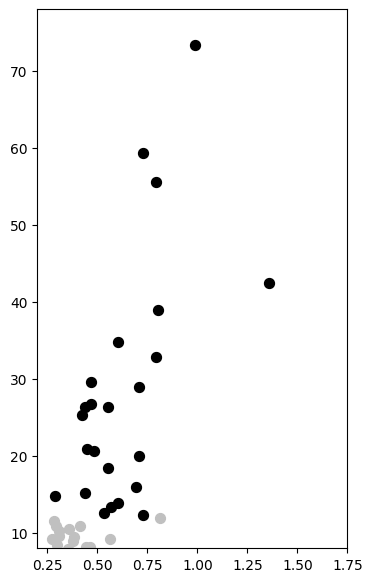

In [865]:
plt.figure(figsize=(4,7))

plt.scatter(x=Mpbpconly['logfoldchanges'],y=Mpbpconly['-logp'],s=50,color='silver')
# plt.scatter(x=pc_ttest[:50]['logfoldchanges'],y=pc_ttest[:50]['-logp'],s=30,color='orange')
plt.scatter(x=Mpbpconly[:25]['logfoldchanges'],y=Mpbpconly[:25]['-logp'],s=50,color='k')
# plt.scatter(x=fold1['logfoldchanges'],y=fold1['-logp'],s=50,color='red')



plt.xlim(0.2,1.75)
plt.ylim(8,78)

(2.0, 82.0)

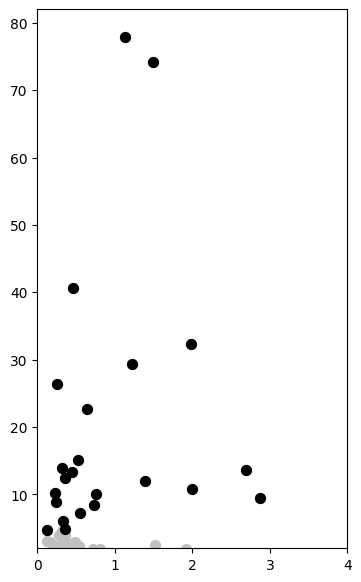

In [866]:
plt.figure(figsize=(4,7))

plt.scatter(x=Gpbpconly['logfoldchanges'],y=Gpbpconly['-logp'],s=50,color='silver')
# plt.scatter(x=pc_ttest[:50]['logfoldchanges'],y=pc_ttest[:50]['-logp'],s=30,color='orange')
plt.scatter(x=Gpbpconly[:25]['logfoldchanges'],y=Gpbpconly[:25]['-logp'],s=50,color='k')
# plt.scatter(x=fold1['logfoldchanges'],y=fold1['-logp'],s=50,color='red')



plt.xlim(0,4)
plt.ylim(2,82)

<!-- #### Gpbpconly[:25].sort_values(by='-logp',ascending=False) -->

In [864]:
Mpbpconly.sort_values(by='-logp',ascending=False)[:26]

,scores,logfoldchanges,pvals,pvals_adj,-logp
names,,,,,
IGHM,48.504,6.491,0.000e+00,0.000e+00,inf
CRELD2,18.640,0.988,1.513e-77,3.931e-74,73.405
MANF,16.799,0.729,2.461e-63,4.477e-60,59.349
HSPA5,16.276,0.793,1.472e-59,2.434e-56,55.614
LARGE1,14.305,1.356,2.038e-46,3.090e-43,42.510
PDIA4,13.720,0.806,7.670e-43,9.966e-40,39.001
SDF2L1,12.983,0.603,1.521e-38,1.729e-35,34.762
FUT8,12.637,0.793,1.323e-36,1.266e-33,32.898
SERP1,12.016,0.469,2.924e-33,2.417e-30,29.617


(50.0, 320.0)

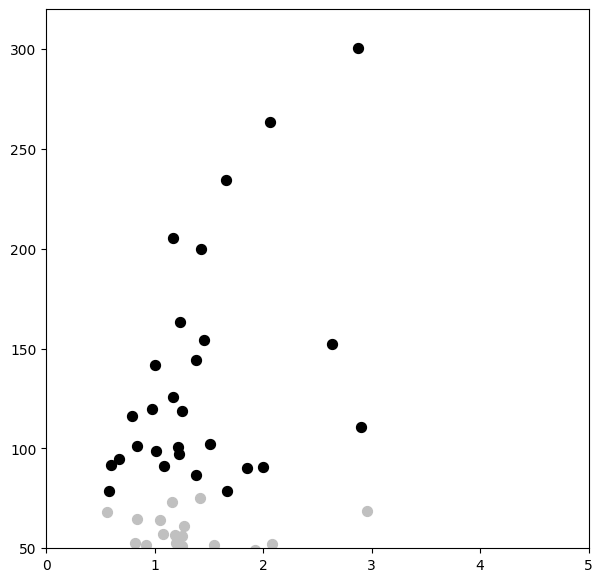

In [117]:
plt.figure(figsize=(7,7))

plt.scatter(x=bpbc['logfoldchanges'],y=bpbc['-logp'],s=50,color='silver')
# plt.scatter(x=pc_ttest[:50]['logfoldchanges'],y=pc_ttest[:50]['-logp'],s=30,color='orange')
plt.scatter(x=bpbc[:31]['logfoldchanges'],y=bpbc[:31]['-logp'],s=50,color='k')
# plt.scatter(x=fold1['logfoldchanges'],y=fold1['-logp'],s=50,color='red')



plt.xlim(0,5)
plt.ylim(50,320)

# plt.xlim(0,1)
# plt.ylim(-1,90)

In [655]:
# pc_ttest=df_rank_genes_groups(pbpc,'PC',)
gpc_t=df_rank_genes_groups(gpbpc,'PC',)
mpc_t=df_rank_genes_groups(mpbpc,'PC',)








In [656]:
# pc_ttest['-logp']=-np.log10(pc_ttest['pvals_adj'])
gpc_t['-logp']=-np.log10(gpc_t['pvals_adj'])
mpc_t['-logp']=-np.log10(mpc_t['pvals_adj'])



In [661]:
gpc_t.to_csv('gpc_t.csv')
mpc_t.to_csv('mpc_t.csv')

In [80]:
pc_ttest[pc_ttest.names.str.startswith("MAMU")]

,scores,names,logfoldchanges,pvals,pvals_adj,-logp
11,8.517504,MAMU-E,0.196811,1.630294e-17,5.086350e-16,15.293594
60,3.089014,MAMU-DRB1,0.094041,2.008220e-03,1.099895e-02,1.958649
73,2.665649,MAMU-A,0.053268,7.683985e-03,3.618017e-02,1.441529
75,2.591757,MAMU-DMB,0.213056,9.548715e-03,4.378159e-02,1.358708
3043,0.011263,MAMU-DOA,0.260213,9.910134e-01,1.000000e+00,-0.000000
9184,-0.274109,MAMU-F,-0.104280,7.840011e-01,1.000000e+00,-0.000000
9835,-0.419574,MAMU-DRA,0.001209,6.747969e-01,1.000000e+00,-0.000000
10212,-0.532556,MAMU-DPA,-0.028562,5.943412e-01,1.000000e+00,-0.000000
14433,-2.689077,MAMU-DOB,-0.130567,7.164982e-03,3.405379e-02,1.467835


In [683]:
gpc_t=pd.read_csv('gpc_t.csv')
mpc_t=pd.read_csv('mpc_t.csv')



In [787]:
# pcl=pc_ttest[(pc_ttest.pvals_adj<0.05)&(pc_ttest.logfoldchanges>0)].names

dfl=bpbc[(bpbc.pvals_adj<0.05)&(bpbc.logfoldchanges>0)].names



In [777]:
Gl=Gpbpc[(Gpbpc.pvals_adj<0.05)&(Gpbpc.logfoldchanges>0)].names
Ml=Mpbpc[(Mpbpc.pvals_adj<0.05)&(Mpbpc.logfoldchanges>0)].names




In [791]:
dfl

0       JCHAIN
1         MZB1
2         SSR4
3        DERL3
4         ARF3
        ...   
325       CTSD
326      RUSF1
327    SLC50A1
328    PPP2R5C
329     MGAT4A
Name: names, Length: 330, dtype: object

In [805]:
Mls=set(dfl)&set(Ml)
Gls=set(dfl)&set(Gl)

In [808]:
Gpbpc=Gpbpc.set_index('names')
Mpbpc=Mpbpc.set_index('names')

In [816]:
Gpbpconly=Gpbpc.iloc[Gpbpc.index.isin(Gls)]
Mpbpconly=Mpbpc.iloc[Mpbpc.index.isin(Mls)]

Gpbpconly.to_csv('Gpbpconly.csv')
Mpbpconly.to_csv('Mpbpconly.csv')

In [657]:
# gl=gpc_t[(gpc_t.pvals_adj<0.05)&(gpc_t.logfoldchanges>0)].names
# ml=mpc_t[(mpc_t.pvals_adj<0.05)&(mpc_t.logfoldchanges>0)].names

In [689]:
gl=set(gpc_t.dropna()['PBPCup'])
ml=set(mpc_t.dropna()['PBPCup'])

In [690]:
#Import libraries
from matplotlib_venn import venn2, venn2_circles, venn2_unweighted
from matplotlib_venn import venn3, venn3_circles
from matplotlib import pyplot as plt
%matplotlib inline


In [699]:
gl-ml

{'CALY', 'CD59', 'IGHG2 ', 'IGHG_1', 'PRDX4'}

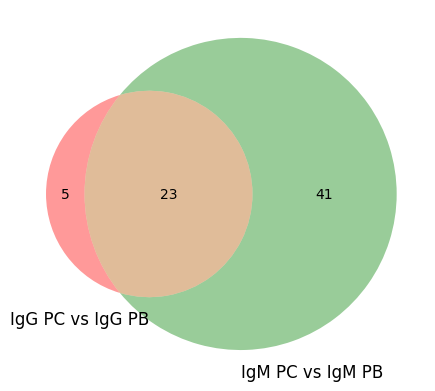

In [692]:
venn2([set(gl),set(ml)],('IgG PC vs IgG PB','IgM PC vs IgM PB') )



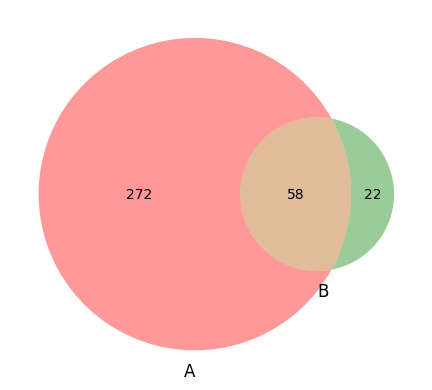

In [133]:
venn2([set(dfl),set(pcl)])



In [698]:
st=str(set(ml)|set(gl))
st=st.replace("'","")
st.replace(",","")

'{GLCCI1 GCN1 FUT8 MBNL2 MAMU-A PRDX4 CYBA CD274 RALGPS2 SCFD2 TNS3 SEC24A FNDC3B LRBA OGT HDLBP DPP7 CALY PSAP CLINT1 CD59 TMED3 RNA 18S RIBOSOMAL SELENOM ITPR2 CD63 ARF3 TMBIM6 SSR4 ZRANB2 FNDC3A SLC39A4 IGF1 TMEM59 CD79A ST6GAL1 ERLEC1 MZB1 BLOC1S5 ERN1 EIF2AK3 CREB3L2 RAPGEF2 HLA B-38 ACHAIN_2 JCHAIN ZNF215 MXD4 MON2 FAM214A HM13 TXNDC11 IGHM BTG2 DAP GMDS APOD B2M 28S RIBOSOMAL RNA HCST RABAC1 TPD52 LOC106993196 TBC1D9 HERPUD1 MAMU-E SEC24D IGHG_1 CNP IGHG2 }'

In [209]:
set(dfl)&set(pcl)

{'28S RIBOSOMAL RNA',
 'AKAP9',
 'ARF3',
 'B2M',
 'BLOC1S5',
 'BTG2',
 'CALY',
 'CD274',
 'CD59',
 'CD63',
 'CD79A',
 'CLINT1',
 'CNP',
 'CREB3L2',
 'CYBA',
 'DERL3',
 'DPP7',
 'EAF2',
 'ERLEC1',
 'ERN1',
 'FAM214A',
 'FNDC3A',
 'FNDC3B',
 'HCST',
 'HDLBP',
 'HERPUD1',
 'HLA, B-38 ACHAIN_2',
 'IGHA1 ',
 'IGHG2 ',
 'IGHG_1',
 'ITPR2',
 'JCHAIN',
 'LOC106993196',
 'LRBA',
 'MAMU-A',
 'MAMU-E',
 'MBNL2',
 'MXD4',
 'MZB1',
 'OGT',
 'PRDX4',
 'RALGPS2',
 'RNA, 18S RIBOSOMAL',
 'S100A10',
 'SEL1L3',
 'SELENOM',
 'SLC39A4',
 'SSR4',
 'ST6GAL1',
 'TBC1D9',
 'TMBIM6',
 'TMEM238',
 'TMEM59',
 'TPD52',
 'TXNDC11',
 'TXNIP',
 'ZFP36',
 'ZNF215'}

In [153]:
sur=pd.read_csv("surfacetome.tsv",sep='\t',)
sur=sur.assign(gene=sur['Gene Names'].str.split(' ')).explode('gene')

surl=list(sur['gene'])

In [155]:
surl

['EPHA2',
 'hCG_24712',
 'NTRK2',
 'hCG_1985371',
 'DRD2',
 'hCG_39593',
 'LDLR',
 'hCG_29965',
 'DDR2',
 'hCG_14697',
 'ACVRL1',
 nan,
 'FSHR',
 nan,
 'EPHA4',
 'hCG_1811889',
 'TGFBR2',
 'hCG_1997782',
 'CD36',
 'hCG_17062',
 'tcag7.257',
 'HTR3E',
 'LILRA5',
 'ILT11',
 'LILRB7',
 'LIR9',
 'CD300LB',
 'CD300B',
 'CLM7',
 'CMRF35A2',
 'IREM3',
 'LMIR5',
 'TREM5',
 'UNQ2530/PRO6029',
 'FBXW7-AS1',
 'DEAR',
 'DEspR',
 'OXTR',
 'hCG_20370',
 'TARM1',
 'ACVR1',
 'hCG_1811747',
 'KLRF2',
 'FZD9',
 'FZD3',
 'GPR25',
 'TLR4',
 'TNFRSF10A',
 'APO2',
 'DR4',
 'TRAILR1',
 'GRM8',
 'GPRC1H',
 'MGLUR8',
 'BMPR1B',
 'F2RL2',
 'PAR3',
 'PGRMC1',
 'HPR6.6',
 'PGRMC',
 'GPR31',
 'CCRL2',
 'CCR11',
 'CCR6',
 'CKRX',
 'CRAM',
 'HCR',
 'CXCR6',
 'BONZO',
 'STRL33',
 'TYMSTR',
 'ACKR2',
 'CCBP2',
 'CCR10',
 'CMKBR9',
 'D6',
 'ADGRB1',
 'BAI1',
 'PTPRT',
 'KIAA0283',
 'TNFRSF10B',
 'DR5',
 'KILLER',
 'TRAILR2',
 'TRICK2',
 'ZTNFR9',
 'UNQ160/PRO186',
 'NRP1',
 'NRP',
 'VEGF165R',
 'TNFSF11',
 'OPGL',
 'RA

In [175]:
set(surl)&(set(pcl)&set(dfl))

{'CD274', 'ITPR2'}

In [301]:
fold1=pc_ttest[:50][pc_ttest['logfoldchanges']>=1]
fold1

,scores,names,logfoldchanges,pvals,pvals_adj,-logp


In [410]:
pc_=pc_ttest[pc_ttest.logfoldchanges!=0]

In [262]:
bpbc=bpbc[bpbc.logfoldchanges!=0]

In [264]:
bpbc.to_csv('bpbc_ex0.csv')

In [411]:
pc_.to_csv('pcpb_ex0.csv')

In [425]:
pc_ttest[:31].sort_values(by='-logp',ascending=False)

,scores,names,logfoldchanges,pvals,pvals_adj,-logp
0,19.45,SSR4,0.48,2.91e-84,7.44e-82,81.13
1,14.98,CYBA,0.50,9.22e-51,1.17e-48,47.93
2,13.58,"RNA, 18S RIBOSOMAL",0.40,4.96e-42,4.72e-40,39.33
3,12.85,TMBIM6,0.39,9.04e-38,7.28e-36,35.14
4,12.21,28S RIBOSOMAL RNA,0.30,2.83e-34,2.00e-32,31.70
5,10.50,MZB1,0.30,8.74e-26,4.55e-24,23.34
6,10.41,HERPUD1,0.40,2.29e-25,1.17e-23,22.93
7,9.97,ERLEC1,0.36,2.06e-23,9.47e-22,21.02
8,9.37,ND2,0.29,7.57e-21,2.91e-19,18.54
9,9.22,SELENOM,0.91,3.08e-20,1.14e-18,17.94


In [352]:
gpc_t[:31].sort_values(by='-logp',ascending=False)

,scores,names,logfoldchanges,pvals,pvals_adj,-logp
0,15.31,SSR4,0.54,6.87e-53,1.98e-50,49.70
1,10.35,"RNA, 18S RIBOSOMAL",0.40,4.17e-25,3.48e-23,22.46
2,9.68,TMBIM6,0.38,3.72e-22,2.57e-20,19.59
3,9.45,IGHG2,0.46,3.41e-21,2.20e-19,18.66
4,8.70,CYBA,0.40,3.21e-18,1.68e-16,15.77
5,7.47,28S RIBOSOMAL RNA,0.24,7.81e-14,2.72e-12,11.57
6,7.20,HERPUD1,0.42,6.22e-13,1.96e-11,10.71
7,6.73,IGHG_1,0.22,1.69e-11,4.65e-10,9.33
8,6.73,ERLEC1,0.32,1.74e-11,4.76e-10,9.32
9,6.09,ND2,0.27,1.10e-09,2.39e-08,7.62


(-1.0, 90.0)

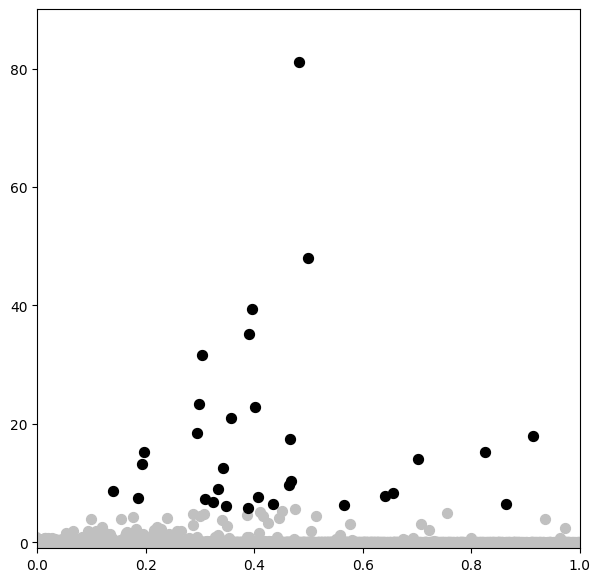

In [353]:
plt.figure(figsize=(7,7))

plt.scatter(x=pc_ttest['logfoldchanges'],y=pc_ttest['-logp'],s=50,color='silver')
# plt.scatter(x=pc_ttest[:50]['logfoldchanges'],y=pc_ttest[:50]['-logp'],s=30,color='orange')
plt.scatter(x=pc_ttest[:31]['logfoldchanges'],y=pc_ttest[:31]['-logp'],s=50,color='k')
# plt.scatter(x=fold1['logfoldchanges'],y=fold1['-logp'],s=50,color='red')



# plt.xlim(-5,5)
# plt.ylim(-5,100)

plt.xlim(0,1)
plt.ylim(-1,90)

(-1.0, 60.0)

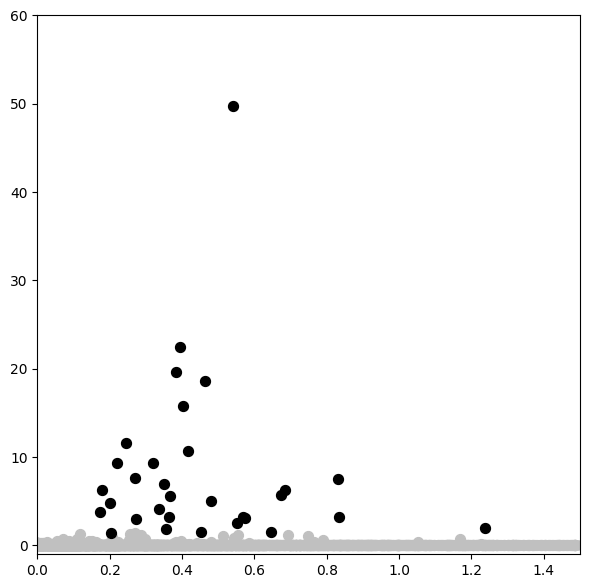

In [367]:
plt.figure(figsize=(7,7))

plt.scatter(x=gpc_t['logfoldchanges'],y=gpc_t['-logp'],s=50,color='silver')
# plt.scatter(x=pc_ttest[:50]['logfoldchanges'],y=pc_ttest[:50]['-logp'],s=30,color='orange')
plt.scatter(x=gpc_t[:31]['logfoldchanges'],y=gpc_t[:31]['-logp'],s=50,color='k')
# plt.scatter(x=fold1['logfoldchanges'],y=fold1['-logp'],s=50,color='red')


# plt.xlim(-5,5)
# plt.ylim(-5,100)




plt.xlim(0,1.5)
plt.ylim(-1,60)

In [366]:
gpc_t[:31].sort_values(by='-logp',ascending=False)

,scores,names,logfoldchanges,pvals,pvals_adj,-logp
0,15.31,SSR4,0.54,6.87e-53,1.98e-50,49.70
1,10.35,"RNA, 18S RIBOSOMAL",0.40,4.17e-25,3.48e-23,22.46
2,9.68,TMBIM6,0.38,3.72e-22,2.57e-20,19.59
3,9.45,IGHG2,0.46,3.41e-21,2.20e-19,18.66
4,8.70,CYBA,0.40,3.21e-18,1.68e-16,15.77
5,7.47,28S RIBOSOMAL RNA,0.24,7.81e-14,2.72e-12,11.57
6,7.20,HERPUD1,0.42,6.22e-13,1.96e-11,10.71
7,6.73,IGHG_1,0.22,1.69e-11,4.65e-10,9.33
8,6.73,ERLEC1,0.32,1.74e-11,4.76e-10,9.32
9,6.09,ND2,0.27,1.10e-09,2.39e-08,7.62


In [371]:
gpc_t[:50]

,scores,names,logfoldchanges,pvals,pvals_adj,-logp
0,15.31,SSR4,0.54,6.87e-53,1.98e-50,49.70
1,10.35,"RNA, 18S RIBOSOMAL",0.40,4.17e-25,3.48e-23,22.46
2,9.68,TMBIM6,0.38,3.72e-22,2.57e-20,19.59
3,9.45,IGHG2,0.46,3.41e-21,2.20e-19,18.66
4,8.70,CYBA,0.40,3.21e-18,1.68e-16,15.77
5,7.47,28S RIBOSOMAL RNA,0.24,7.81e-14,2.72e-12,11.57
6,7.20,HERPUD1,0.42,6.22e-13,1.96e-11,10.71
7,6.73,IGHG_1,0.22,1.69e-11,4.65e-10,9.33
8,6.73,ERLEC1,0.32,1.74e-11,4.76e-10,9.32
9,6.09,ND2,0.27,1.10e-09,2.39e-08,7.62


In [ ]:
plt.figure(figsize=(7,7))

plt.scatter(x=mpc_t['logfoldchanges'],y=mpc_t['-logp'],s=50,color='silver')
# plt.scatter(x=pc_ttest[:50]['logfoldchanges'],y=pc_ttest[:50]['-logp'],s=30,color='orange')
plt.scatter(x=mpc_t[:31]['logfoldchanges'],y=mpc_t[:31]['-logp'],s=50,color='k')
# plt.scatter(x=fold1['logfoldchanges'],y=fold1['-logp'],s=50,color='red')


# plt.xlim(-5,5)
# plt.ylim(-5,100)



plt.xlim(0,1.2)
plt.ylim(-1,35)

In [529]:
marker_genes=['SSR4','CYBA','TMBIM6','CD59']+list(pc_ttest[5:35].names)


In [530]:
marker_genes

['SSR4',
 'CYBA',
 'TMBIM6',
 'CD59',
 'MZB1',
 'HERPUD1',
 'ERLEC1',
 'ND2',
 'SELENOM',
 'CUTA',
 'MAMU-E',
 'TBC1D9',
 'ITPR2',
 'B2M',
 'CD63',
 'RSRP1',
 'PNISR',
 'BTG2',
 'JCHAIN',
 'CD274',
 'TXNIP',
 'FNDC3B',
 'TMEM59',
 'ST6GAL1',
 'TPD52',
 'CNP',
 'TXNDC11',
 'OGT',
 'CLINT1',
 'IGHG2 ',
 'LRBA',
 'FAM214A',
 'ERN1',
 'CD79A']

In [531]:
marker_genes=list(set(marker_genes)-set(['ND2','CUTA','B2M','RSRP1','PNISR','TXNIP','AIM2']))
marker_genes.sort()

In [532]:
marker_genes

['BTG2',
 'CD274',
 'CD59',
 'CD63',
 'CD79A',
 'CLINT1',
 'CNP',
 'CYBA',
 'ERLEC1',
 'ERN1',
 'FAM214A',
 'FNDC3B',
 'HERPUD1',
 'IGHG2 ',
 'ITPR2',
 'JCHAIN',
 'LRBA',
 'MAMU-E',
 'MZB1',
 'OGT',
 'SELENOM',
 'SSR4',
 'ST6GAL1',
 'TBC1D9',
 'TMBIM6',
 'TMEM59',
 'TPD52',
 'TXNDC11']

In [533]:
rnann=rnan[rnan.obs.pheno!='amb']

In [121]:
sc.pl.dotplot(rnann, marker_genes, 'pheno',cmap='coolwarm', standard_scale='var', 
              categories_order=['ActB','prePB','PB','PC'])


NameError: name 'marker_genes' is not defined

In [1012]:
ora=pd.read_csv('ora_pbpc.txt',sep='\t')

In [1015]:
ora=ora.sort_values(by='enrichmentRatio',ascending=False)


In [1031]:
ora=ora.set_index('description')

In [1043]:
heat=ora.enrichmentRatio

In [1045]:
heat

description
endoplasmic reticulum to cytosol transport     35.789742
protein exit from endoplasmic reticulum        26.059670
peptidyl-asparagine modification               19.883190
ER-nucleus signaling pathway                   12.371763
response to topologically incorrect protein     9.476244
response to endoplasmic reticulum stress        8.724863
glycoprotein metabolic process                  4.568035
Golgi vesicle transport                         3.954908
neutrophil mediated immunity                    3.367314
granulocyte activation                          3.340376
Name: enrichmentRatio, dtype: float64

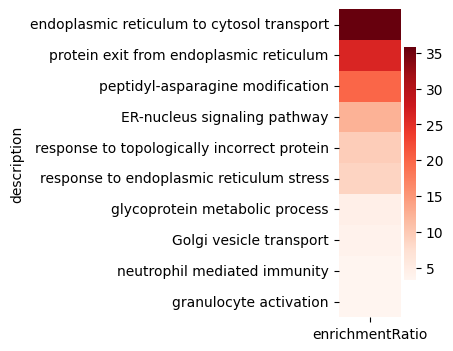

In [1048]:
fig = plt.figure(figsize=(1,4))
heatmap=pd.DataFrame(heat,  index=heat.index)
# cmap=sns.diverging_palette(220,10,sep=30, n=7, as_cmap=True)
sns.heatmap(heatmap, cmap='Reds')
# plt.savefig('gsea_G_hall.pdf')
plt.show()

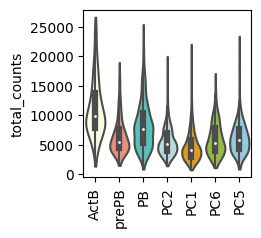

In [1175]:

with rc_context({'figure.figsize': (3, 2.3)}):
    sc.pl.violin(rnah, ['total_counts'], groupby='Bcat', stripplot=False, inner='box',
                 order=['ActB','prePB','PB','PC2','PC1','PC6','PC5'],
                palette={'ActB':'lightyellow','prePB':'salmon','PB':'mediumturquoise','PC2':'powderblue','PC1':'orange',
                        'PC6':'yellowgreen','PC5':'skyblue'},rotation=90 )





In [1136]:
rpb=rna[rna.obs.Bcat=='PB']
rpc5=rna[rna.obs.Bcat=='PC5']
rpc6=rna[rna.obs.Bcat=='PC6']

In [1145]:
pb=rnan[rnan.obs.Bcat=='PB']
pc5=rnan[rnan.obs.Bcat=='PC5']
pc6=rnan[rnan.obs.Bcat=='PC6']

/var/folders/l2/wqv877ys4072cj6jczcxysq4cbkzd0/T/ipykernel_99058/3590849279.py:3: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=False`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(rpb.obs_vector(x),
/var/folders/l2/wqv877ys4072cj6jczcxysq4cbkzd0/T/ipykernel_99058/3590849279.py:5: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(rpc5.obs_vector(x),
/var/folders/l2/wqv877ys4072cj6jczcxysq4cbkzd0/T/ipykernel_99058/3590849279.py:7: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=False`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(rpc6.obs_vector(x),


<AxesSubplot: ylabel='Density'>

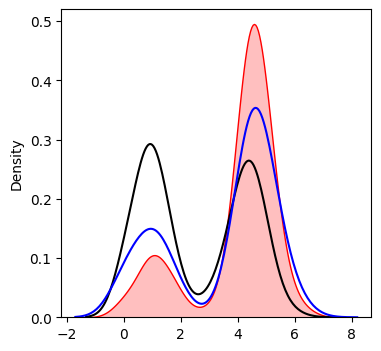

In [1178]:
fig = plt.figure(figsize=(4,4))
x='IGHG2 '
sns.kdeplot(rpb.obs_vector(x),
             color = 'k',shade=False)
sns.kdeplot(rpc5.obs_vector(x), 
             color = 'r',shade=True)
sns.kdeplot(rpc6.obs_vector(x), 
             color = 'b',shade=False)

/var/folders/l2/wqv877ys4072cj6jczcxysq4cbkzd0/T/ipykernel_99058/495559658.py:3: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=False`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(pb.obs_vector(x),
/var/folders/l2/wqv877ys4072cj6jczcxysq4cbkzd0/T/ipykernel_99058/495559658.py:5: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(pc5.obs_vector(x),
/var/folders/l2/wqv877ys4072cj6jczcxysq4cbkzd0/T/ipykernel_99058/495559658.py:7: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=False`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(pc6.obs_vector(x),


<AxesSubplot: ylabel='Density'>

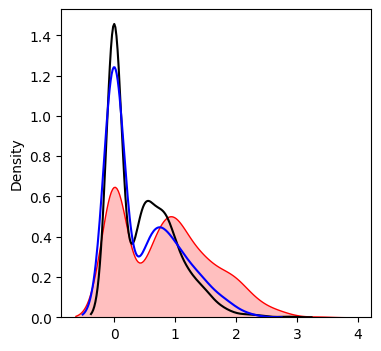

In [1177]:
fig = plt.figure(figsize=(4,4))
x='CD274'
sns.kdeplot(pb.obs_vector(x),
             color = 'k',shade=False)
sns.kdeplot(pc5.obs_vector(x), 
             color = 'r',shade=True)
sns.kdeplot(pc6.obs_vector(x), 
             color = 'b',shade=False)

In [224]:
ldata = scv.read('possorted_genome_bam_G06TB.loom', cache=True)
adata = scv.utils.merge(adata, ldata)

In [276]:
xpc.obs['xpc'].cat.reorder_categories(['Mpc', 'Apc','Gpc'], inplace=True)


/var/folders/l2/wqv877ys4072cj6jczcxysq4cbkzd0/T/ipykernel_1133/361894911.py:1: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  xpc.obs['xpc'].cat.reorder_categories(['Mpc', 'Apc','Gpc'], inplace=True)


In [326]:
markers=list(mpc_ttest['names'][1:35])

In [344]:
apc_ttest[:60]

,scores,names,logfoldchanges,pvals,pvals_adj
0,95.892204,IGHA1,8.723677,1.389518e-150,2.969261e-146
1,6.078695,VIM,0.849302,8.105587e-09,1.219777e-06
2,5.848151,ITGB7,1.002844,2.658709e-08,3.272497e-06
3,5.540599,JCHAIN,0.408589,1.104361e-07,1.128569e-05
4,5.348743,BLOC1S5,0.691222,2.896188e-07,2.362162e-05
5,4.604498,CRELD2,0.591858,8.131814e-06,4.187199e-04
6,4.541147,S100A13,1.452477,1.102988e-05,5.468617e-04
7,4.193476,PPP3CC,0.865099,4.502677e-05,1.829234e-03
8,3.884318,S100A1,1.193402,1.500801e-04,5.018876e-03
9,3.691602,THAP6,1.722574,3.077330e-04,9.070272e-03


In [332]:
# markers_=["B2M",'MZB1','-968','SSR4','CYBA','TMBIM6','SEC11C',]
markers_=['JCHAIN','IGLC','BLOC155']

In [333]:
mark=list(set(markers)-set(markers_))


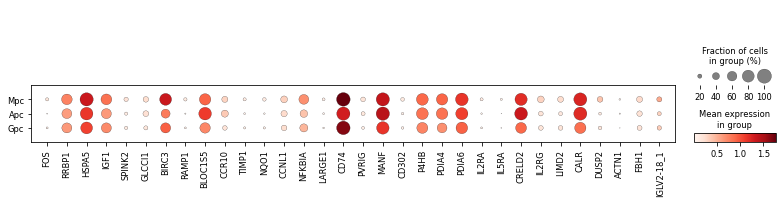

In [336]:
sc.pl.dotplot(xpc,mark,groupby='xpc',cmap='Reds')


In [41]:
pc_ttest=df_rank_genes_groups(pbpc,'pc',pval_cutoff=0.05)

In [89]:
pc_x_ttest=df_rank_genes_groups(nhp,'pc',pval_cutoff=0.05)

In [215]:
(np.sum(pb.obs_vector('CD63'))+np.sum(ab.obs_vector('CD63')))/(len(pb)+len(ab))

0.5999872298609754

In [216]:
np.mean(pc.obs_vector('CD63'))

0.991082

In [44]:
pc_ttest.to_csv('pc_ttest.csv')


In [90]:
pc_x_ttest.to_csv('pc_x_ttest.csv')


In [137]:
nhp

AnnData object with n_obs × n_vars = 3438 × 34884
    obs: 'donor', 'batch', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'louvain'
    var: 'gene_ids', 'feature_types', 'genome', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
    uns: 'log1p', 'pca', 'neighbors', 'umap', 'leiden', 'louvain', 'leiden_colors', 'louvain_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'distances', 'connectivities'

In [198]:
Lmarker=list(nhp.var_names[nhp.var_names.str.startswith('IGLC')])
Kmarker=list(nhp.var_names[nhp.var_names.str.startswith('IGKC')])

In [350]:
nhp.var_names[nhp.var.gene_ids.str.contains('54391')]

Index([], dtype='object')

In [199]:
lightc=Lmarker+Kmarker

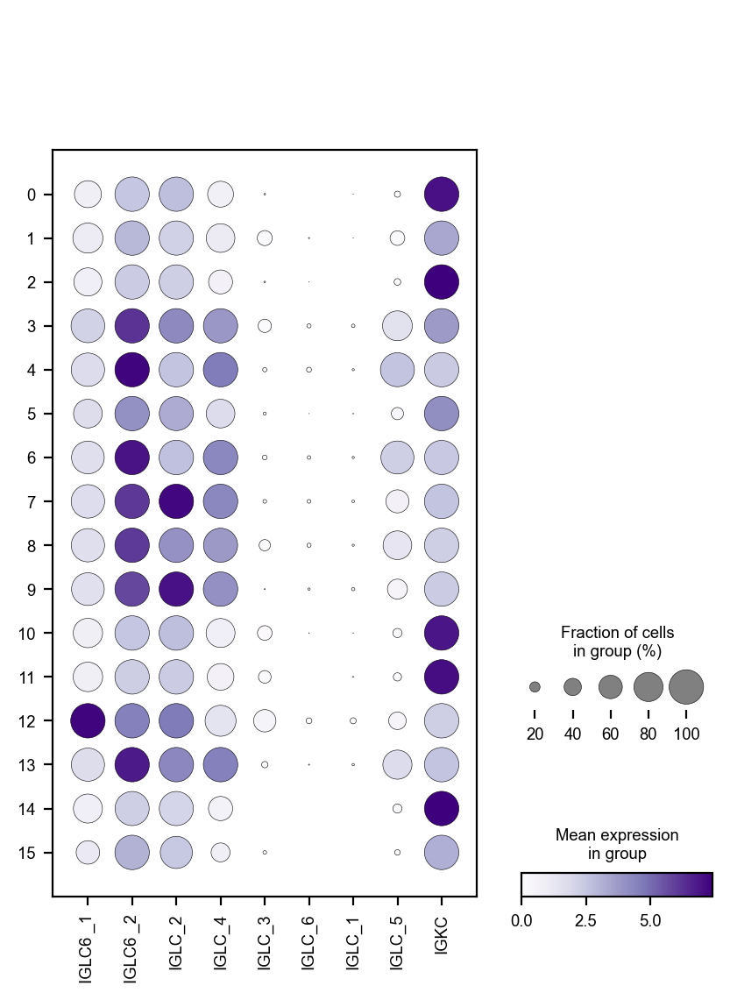

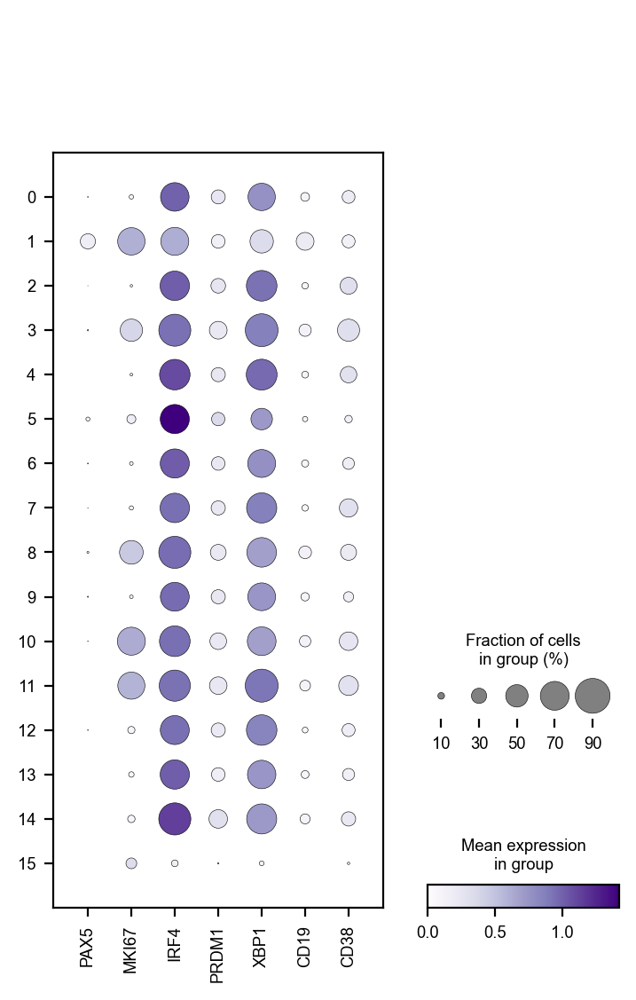

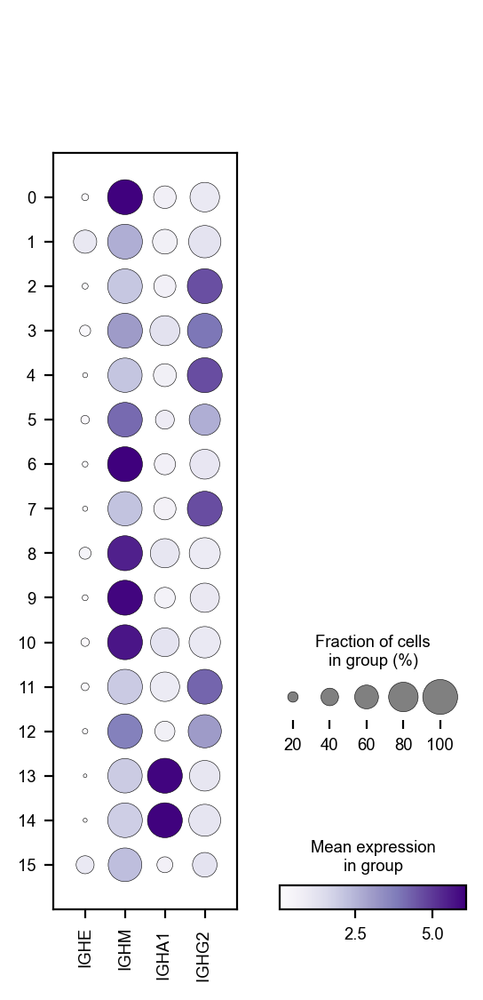

In [332]:
# sc.pl.dotplot(nhp,Lmarker,groupby='leiden',cmap='Purples')
# sc.pl.dotplot(nhp,Kmarker,groupby='leiden',cmap='Purples')
sc.pl.dotplot(nhp,lightc,groupby='leiden',cmap='Purples')
sc.pl.dotplot(nhp,['PAX5','MKI67','IRF4','PRDM1','XBP1','CD19','CD38'],groupby='leiden',cmap='Purples')
sc.pl.dotplot(nhp,["IGHE",'IGHM','IGHA1 ','IGHG2 '],groupby='leiden',cmap='Purples')


In [282]:
import dynamo as dyn


/Users/ycheng/opt/anaconda3/envs/scanpy/lib/python3.8/site-packages/nxviz/__init__.py:18: UserWarning: 
nxviz has a new API! Version 0.7.3 onwards, the old class-based API is being
deprecated in favour of a new API focused on advancing a grammar of network
graphics. If your plotting code depends on the old API, please consider
pinning nxviz at version 0.7.3, as the new API will break your old code.

To check out the new API, please head over to the docs at
https://ericmjl.github.io/nxviz/ to learn more. We hope you enjoy using it!

(This deprecation message will go away in version 1.0.)

  warnings.warn(


KeyError: 'dynamo-release'

In [26]:
Larray=np.zeros(len(nhp))
for i in Lmarker:
    Larray=nhp.obs_vector(i)+Larray
Karray=np.zeros(len(nhp))
for i in Kmarker:
    Karray=nhp.obs_vector(i)+Karray

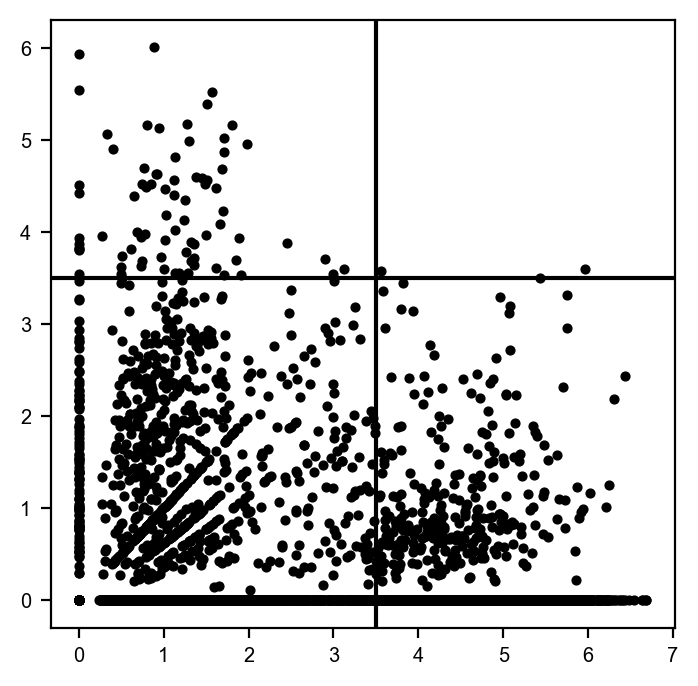

In [337]:

x='IGHG2 '
y='IGHE'
fig=plt.figure(figsize=(4,4))
# plt.scatter(x,y,color='slategrey',s=10)
plt.scatter(nhp.obs_vector(x),nhp.obs_vector(y),color="k",s=10)
plt.axvline(x=3.5)
plt.axhline(y=3.5)

In [223]:
an=n633
[sum(an.obs.leiden=='0')+sum(an.obs.leiden=='1')+sum(an.obs.leiden=='6')+sum(an.obs.leiden=='8')+sum(an.obs.leiden=='9'),
sum(an.obs.leiden=='2')+sum(an.obs.leiden=='3')+sum(an.obs.leiden=='5')]


[691, 429]

In [219]:
sum(an.obs.leiden=='2')+sum(an.obs.leiden=='3')+sum(an.obs.leiden=='5')

1197

In [210]:
sum(nhp.obs.leiden=='4')+sum(nhp.obs.leiden=='7')

560

In [211]:
560+1626+1994

4180

In [222]:
691/429,1303/1197,1994/1626

(1.6107226107226107, 1.0885547201336676, 1.2263222632226323)

<BarContainer object of 3 artists>

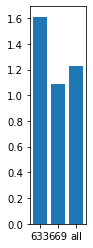

In [226]:
x=['633','669','all']
y=[691/429,1303/1197,1994/1626]

fig = plt.figure(figsize=(1,4))
plt.bar(x,y)

In [611]:
nhp_t=nhp_raw.copy()

In [612]:
nhp_t=nhp_t[nhp_t.obs.index.isin(nhp_.obs.index)]

In [613]:
searchfor=['IGHEP1','IGHEP2','IGHMBP2','IGHGP']
iglist=nhp.var_names.str.startswith(('IGK','IGL')) & ~nhp.var_names.str.contains('|'.join(searchfor))
nhp_t=nhp_t[:,~iglist]



In [614]:
sc.pp.normalize_total(nhp_t)
sc.pp.log1p(nhp_t)


/Users/ycheng/opt/anaconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


In [615]:
sc.pp.pca(nhp_t)
sc.pp.neighbors(nhp_t, n_neighbors=22,n_pcs=30)   
sc.tl.umap(nhp_t)
sc.tl.louvain(nhp_t,resolution = 1.0, key_added="louvain")

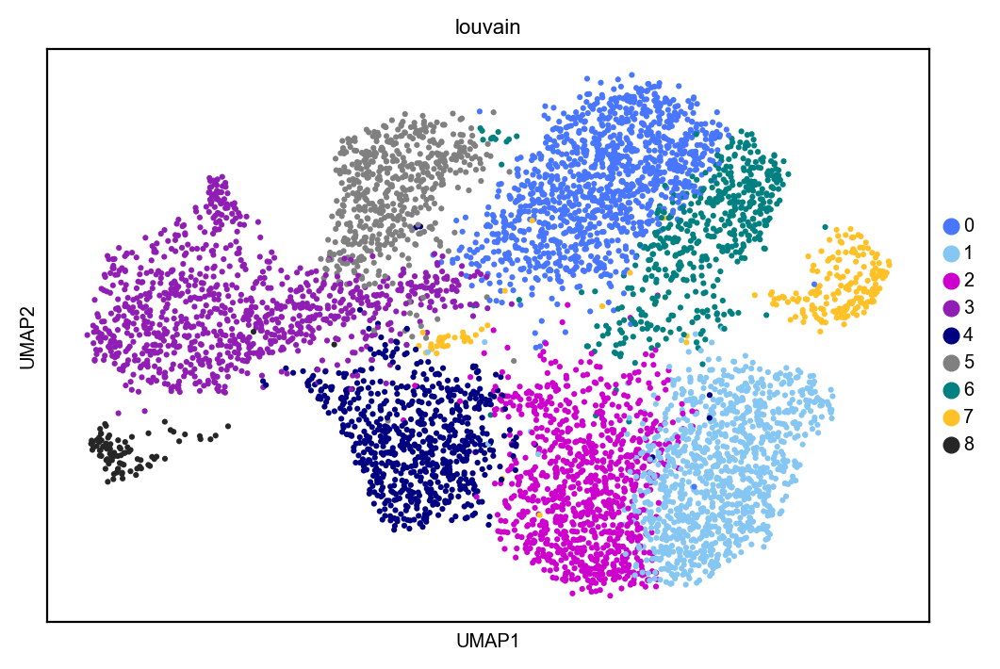

In [616]:
sc.pl.umap(nhp_t,color="louvain")


In [617]:
sc.tl.paga(nhp_t, groups='louvain')


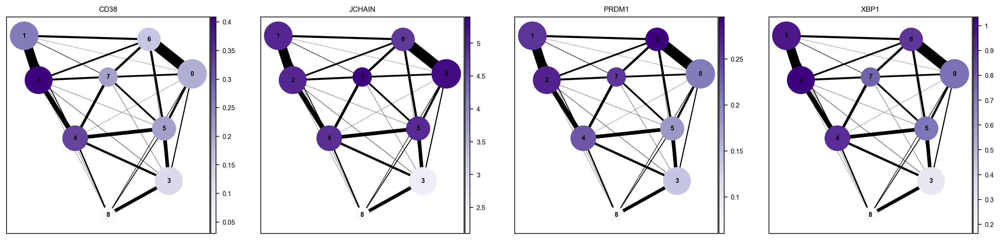

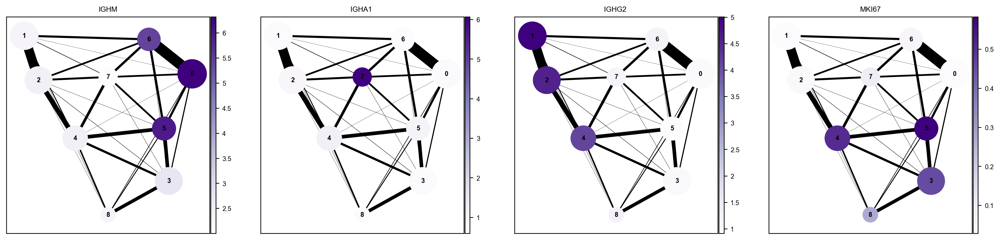

In [618]:
with rc_context({'figure.figsize': (4, 4)}):
    sc.pl.paga(nhp_t,node_size_scale=5,edge_width_scale=2, color=['CD38', 'JCHAIN', 'PRDM1', 'XBP1'],cmap="Purples")
    sc.pl.paga(nhp_t,node_size_scale=5,edge_width_scale=2, color=['IGHM', 'IGHA1 ', 'IGHG2 ', 'MKI67'],cmap="Purples")

    

In [619]:
nhp_t_=nhp_t.copy()

In [620]:
sc.tl.diffmap(nhp_t_)
sc.pp.neighbors(nhp_t_, n_neighbors=20, use_rep='X_diffmap')

In [621]:
sc.tl.draw_graph(nhp_t_, init_pos='paga')

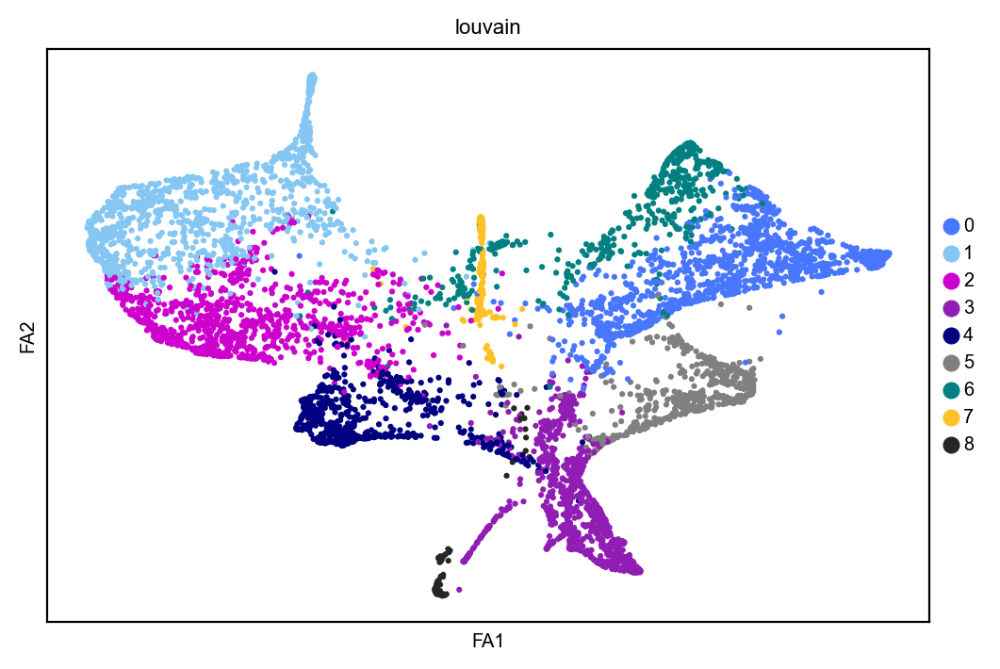

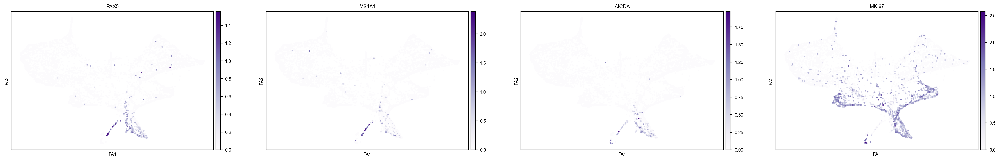

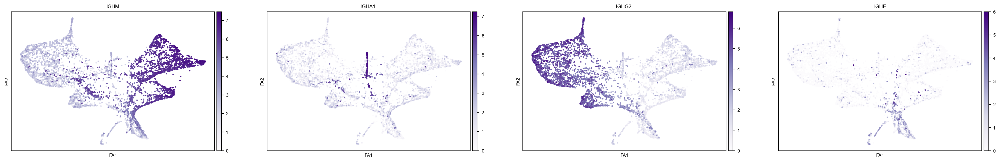

In [622]:
sc.pl.draw_graph(nhp_t_, color=['louvain'],s=20)
sc.pl.draw_graph(nhp_t_, color=['PAX5','MS4A1','AICDA','MKI67'], legend_loc='on data',s=20,cmap="Purples")
sc.pl.draw_graph(nhp_t_, color=['IGHM','IGHA1 ','IGHG2 ','IGHE'], legend_loc='on data',s=20,cmap="Purples")


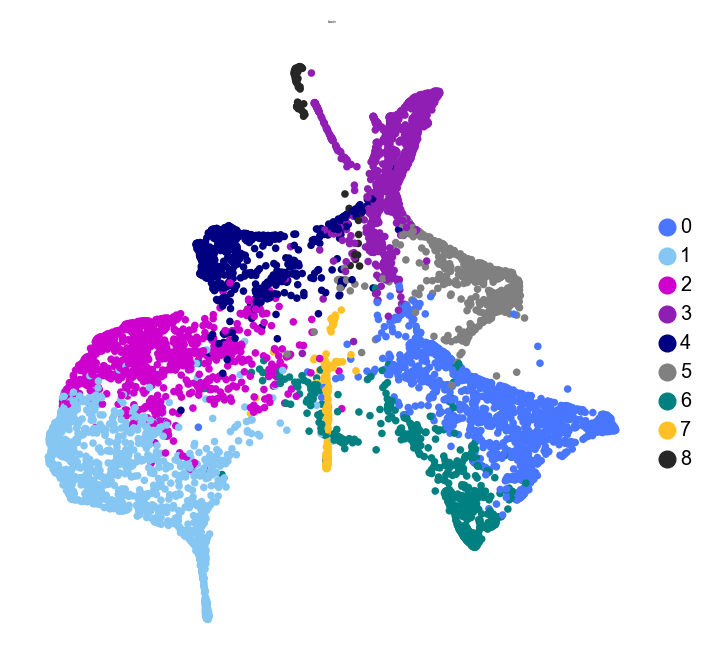

In [634]:
with rc_context({'figure.figsize': (4, 4),'axes.labelsize': False,'axes.titlesize':False}):
    ax = plt.gca()
    ax.invert_yaxis()
    sc.pl.draw_graph(nhp_t_, color=['louvain'],s=30,frameon=False, ax=ax)

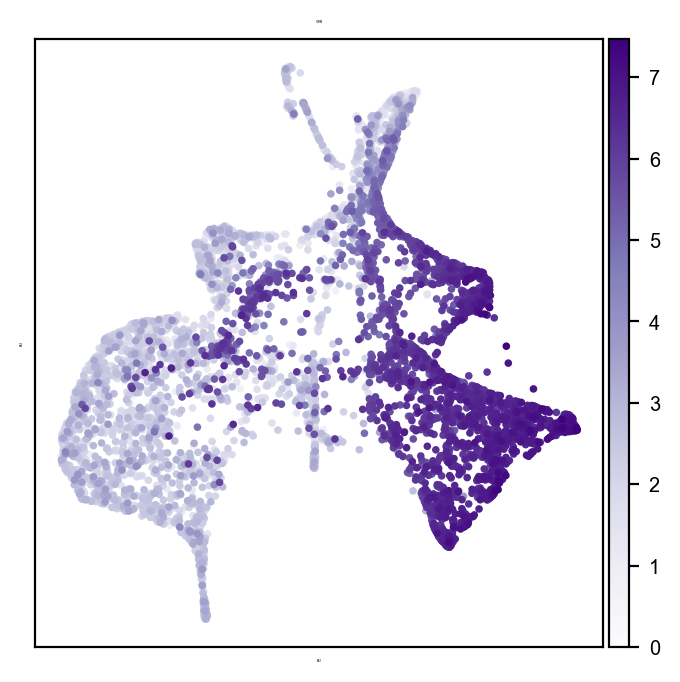

In [640]:
with rc_context({'figure.figsize': (4, 4),'axes.labelsize': False,'axes.titlesize':False}):
    ax = plt.gca()
    ax.invert_yaxis()
    sc.pl.draw_graph(nhp_t_, color=['IGHM'], legend_loc='on data',s=30,cmap="Purples",ax=ax)